In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import dandelion as ddl
sc.logging.print_versions()

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/NC_study/scanpy'))

scanpy==1.5.1 anndata==0.7.4 umap==0.4.6 numpy==1.19.1 scipy==1.5.1 pandas==1.0.5 scikit-learn==0.23.1 statsmodels==0.11.1 python-igraph==0.8.2 leidenalg==0.8.1


In [2]:
# Set up the sample info
sampleInfo = pd.read_csv('/home/jovyan/NC_study/sampleInfo_control.csv')
sampleInfo

,sampleid,age_group,patient,sampletype,gender,cohort
0,Sample_Fq_4,Young,C20,Blood,M,Healthy
1,Sample_Fq_5,Young,C20,Nasal,M,Healthy
2,Sample_Fq_8,Old,C19,Blood,F,Healthy
3,Sample_Fq_9,Old,C19,Nasal,F,Healthy
4,Sample_Fq_10,Old,C24,Blood,M,Healthy
5,Sample_Fq_11,Old,C24,Nasal,M,Healthy
6,Sample_Fq_14,Old,C21,Blood,M,Healthy
7,Sample_Fq_15,Old,C21,Nasal,M,Healthy
8,Sample_Fq_18,Young,C17,Blood,M,Healthy
9,Sample_Fq_19,Young,C17,Nasal,M,Healthy


In [ ]:
# read it as a list
adata_list = []
# for i in range(0, len(sampleInfo['10x_ID'])):
for i in sampleInfo.index:            
    # import data
    inputfile='/home/jovyan/NC_study/raw/Trans/COMBIVAS/'+sampleInfo['sampleid'].at[i]+'/filtered_feature_bc_matrix'
    adata = sc.read_10x_mtx(inputfile)
    adata.obs['sampleid'] = sampleInfo['sampleid'].at[i]
    adata.obs['patient'] = sampleInfo['patient'].at[i]    
    adata.obs['sampletype'] = sampleInfo['sampletype'].at[i]
    adata.obs['age_group'] = sampleInfo['age_group'].at[i]
    adata.obs['gender'] = sampleInfo['gender'].at[i]
    adata.obs['cohort'] = sampleInfo['cohort'].at[i]
    # rename cells to sample id + barcode, cleaving the trailing -1
    adata.obs_names = [str(sampleInfo['sampleid'].at[i])+'_'+str(j).split('-')[0] for j in adata.obs_names]
    adata.layers['counts'] = adata.X.copy()
    rna = adata[:, adata.var["feature_types"] == "Gene Expression"].copy()
    # using dandelion's qc recipe to mark doublets with scrublet and low quality cells based on standard metrics
    # default settings are max_genes=2500, min_genes=200, mito_cutoff=0.05, pval_cutoff=0.1, min_counts=None, max_counts=None
    ddl.pp.recipe_scanpy_qc(rna, mito_cutoff = 0.1)
    adata.obs = rna.obs.copy()    
    adata_list.append(adata)
adata = adata_list[0].concatenate(adata_list[1:], index_unique=None)
adata.obs['patient'] = adata.obs['patient'].astype('category')
adata

In [4]:
adata.var["feature_types"].value_counts()

Gene Expression    33538
Name: feature_types, dtype: int64

In [5]:
# How many doublets did scrublet pick up?
adata.obs['is_doublet'].value_counts()

False    66400
True      4843
Name: is_doublet, dtype: int64

In [6]:
# How many cells are `bad quality`
adata.obs['filter_rna'].value_counts()

False    60895
True     10348
Name: filter_rna, dtype: int64

In [7]:
# Remove the bad quality cells and continue
adata = adata[adata.obs['filter_rna'] != True]
adata

View of AnnData object with n_obs × n_vars = 60895 × 33538
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch'
    var: 'gene_ids', 'feature_types'
    layers: 'counts'

In [8]:
# check how many cells
pd.crosstab(adata.obs['sampletype'], adata.obs['patient'])

patient,C17,C19,C20,C21,C24,C26
sampletype,,,,,,
Blood,5512,7037,5124,5099,3623,0
Nasal,13923,9210,1586,4157,1631,3993


In [9]:
# filter genes
sc.pp.filter_genes(adata, min_cells = 3)
# create a separate object to hold the raw counts
adata_raw = adata.copy()
# also do this
adata.layers["counts"] = adata.X.copy()
adata_raw.layers["counts"] = adata_raw.X.copy()

Trying to set attribute `.var` of view, copying.


... storing 'sampleid' as categorical
... storing 'sampletype' as categorical
... storing 'group' as categorical
... storing 'gender' as categorical
... storing 'is_doublet' as categorical
... storing 'feature_types' as categorical


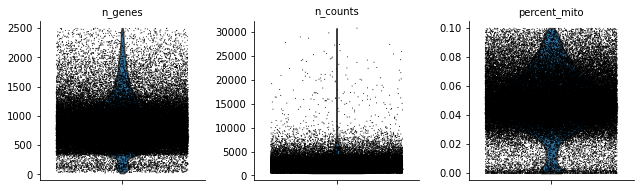

In [10]:
# violin plot of the computed quality measures.
sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'], jitter = 0.4, multi_panel = True)

In [11]:
# normalize to 10000 counts per cell
sc.pp.normalize_total(adata, target_sum = 1e4)
sc.pp.log1p(adata)
# stash the normalized data in raw
adata.raw = adata
adata

AnnData object with n_obs × n_vars = 60895 × 20764
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch'
    var: 'gene_ids', 'feature_types', 'n_cells'
    uns: 'log1p'
    layers: 'counts'

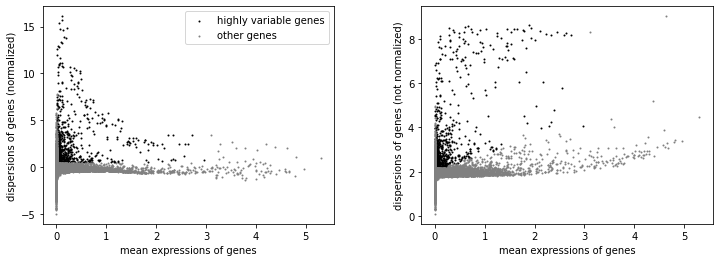

In [12]:
# Identify highly-variable genes
sc.pp.highly_variable_genes(adata, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
# plot highly_variable_genes
sc.pl.highly_variable_genes(adata)

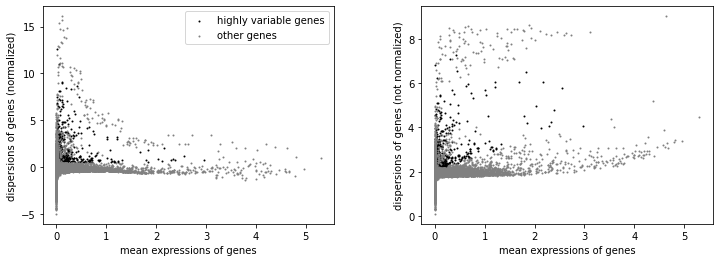

In [13]:
## remove TRBV/TRAV/TRGV/TRDV and IGHV/IGLV/IGKV from the highly variable genes
import re
for i in adata.var.index:
    if re.search('^TR[ABGD]V|^IG[HKL]V', i):
        adata.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(adata)

In [14]:
# filter to only highly variable
adata = adata[:, adata.var['highly_variable']]
adata

View of AnnData object with n_obs × n_vars = 60895 × 746
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p'
    layers: 'counts'

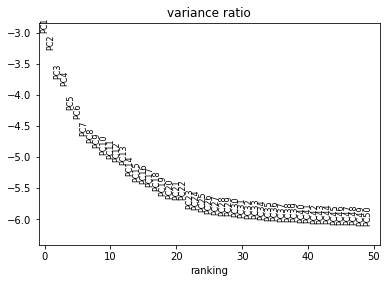

In [15]:
import multiprocessing
# regress and scale for PCA
sc.pp.regress_out(adata, ['n_counts', 'percent_mito'], n_jobs = multiprocessing.cpu_count()-4)
sc.pp.scale(adata, max_value = 10)
# Principal component analysis
sc.tl.pca(adata, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(adata, log = True, n_pcs = 50)

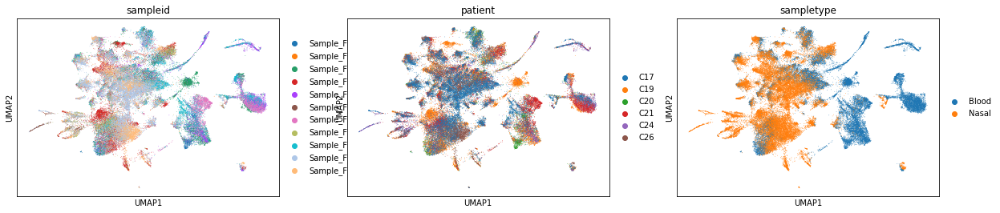

In [16]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(adata, n_neighbors = 10, n_pcs = 50)
# run UMAP
sc.tl.umap(adata, n_components = 2, min_dist = 0.3)
sc.pl.umap(adata, color=['sampleid', 'patient', 'sampletype'])

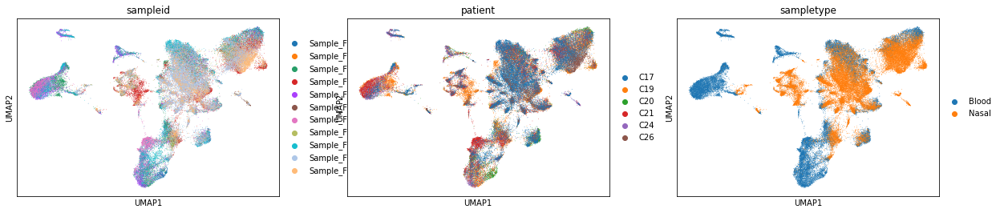

In [17]:
# run BBKNN
sc.external.pp.bbknn(adata, batch_key = 'patient', neighbors_within_batch=10)
# UMAP
sc.tl.umap(adata, n_components = 2, min_dist = 0.3)
sc.pl.umap(adata, color=['sampleid', 'patient', 'sampletype'])

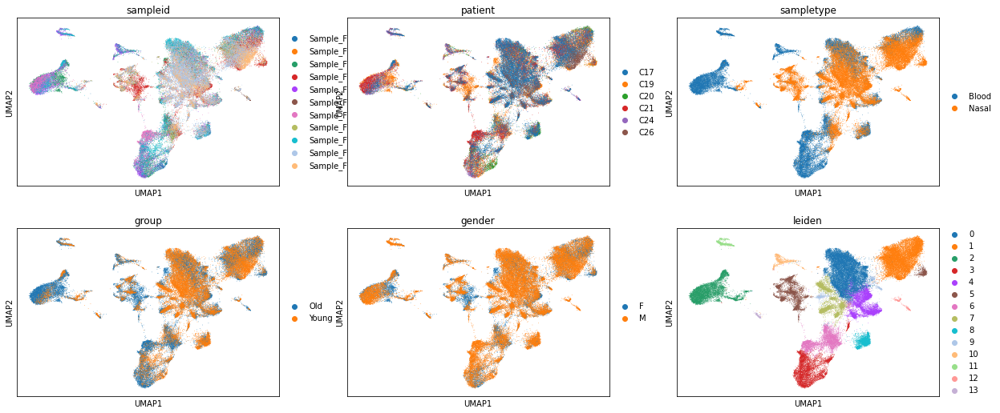

In [18]:
# find clusters
sc.tl.leiden(adata, resolution =0.5)
sc.pl.umap(adata, color=['sampleid', 'patient', 'sampletype', 'group', 'gender', 'leiden'], ncols = 3)

In [19]:
# create a palette for umap
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
viridis = cm.get_cmap('viridis', 256)
newcolors = viridis(np.linspace(0, 1, 256))
grey = np.array([215/256, 215/256, 215/256, 1])
newcolors[:1, :] = grey
newcmp = ListedColormap(newcolors)

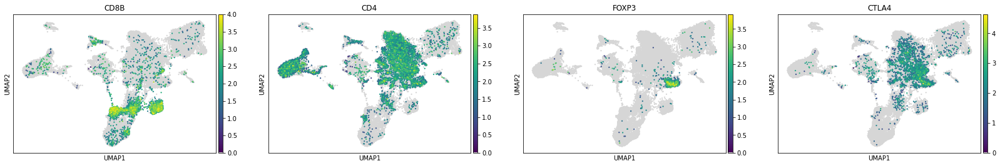

In [20]:
sc.pl.umap(adata, color = ['CD8B', 'CD4', 'FOXP3', 'CTLA4'], color_map = newcmp, size = 20)

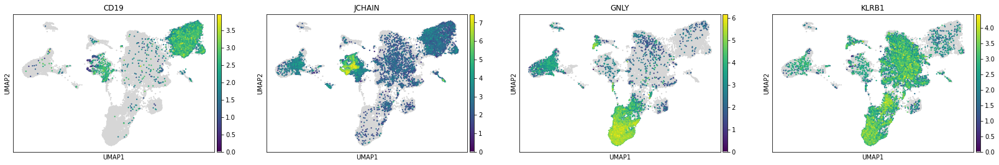

In [21]:
sc.pl.umap(adata, color = ['CD19', 'JCHAIN', 'GNLY', 'KLRB1'], color_map = newcmp, size = 20)

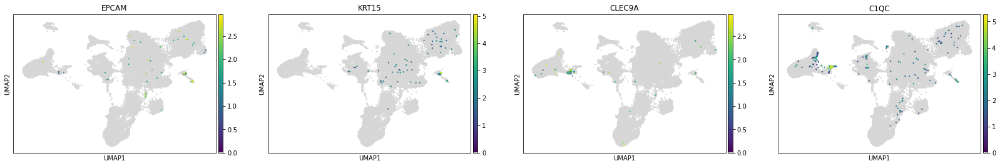

In [22]:
sc.pl.umap(adata, color = ['EPCAM', 'KRT15', 'CLEC9A', 'C1QC'], color_map = newcmp, size = 20)

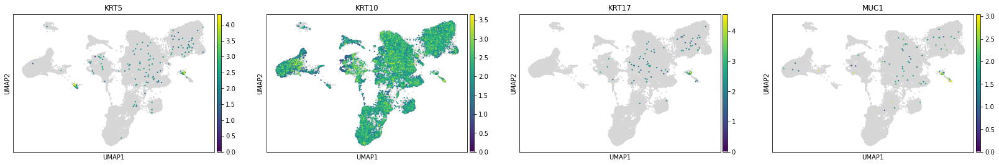

In [23]:
sc.pl.umap(adata, color = ['KRT5', 'KRT10', 'KRT17', 'MUC1'], color_map = newcmp, size = 20)

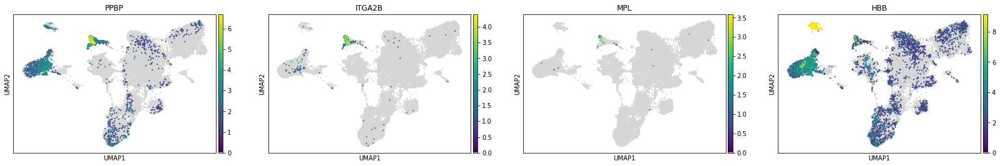

In [24]:
sc.pl.umap(adata, color = ['PPBP', 'ITGA2B', 'MPL', 'HBB'], color_map = newcmp, size = 20)

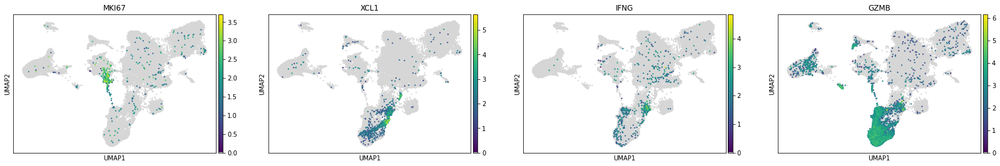

In [25]:
sc.pl.umap(adata, color = ['MKI67', 'XCL1', 'IFNG', 'GZMB'], color_map = newcmp, size = 20)

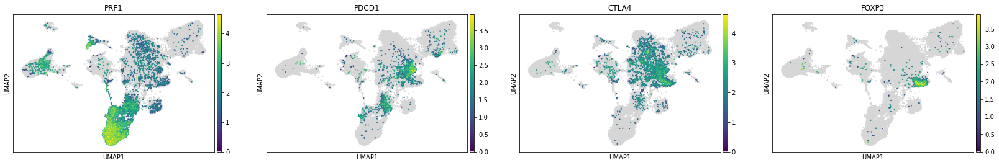

In [26]:
sc.pl.umap(adata, color = ['PRF1', 'PDCD1', 'CTLA4', 'FOXP3'], color_map = newcmp, size = 20)

In [27]:
# run marker gene test
sc.tl.rank_genes_groups(adata, groupby = 'leiden', method = 'wilcoxon', n_genes = 30000)

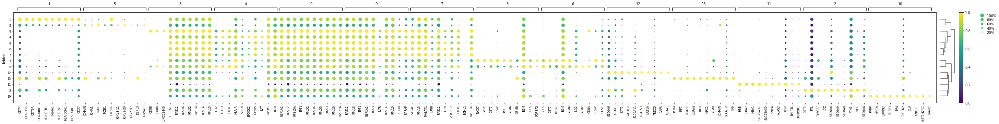

In [28]:
sc.pl.rank_genes_groups_dotplot(adata, n_genes = 10, standard_scale = 'var', color_map = 'viridis')

### Check cluster positions again

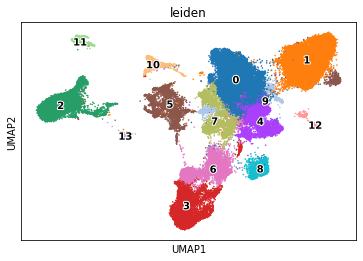

In [29]:
sc.pl.umap(adata, color = ['leiden'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

## Sub-clustering for fine cell type annotation

First create a new column called `leiden_R_label` which I will update as I progress through.

In [30]:
adata.obs['fine_label'] = adata.obs['leiden']

### T cell

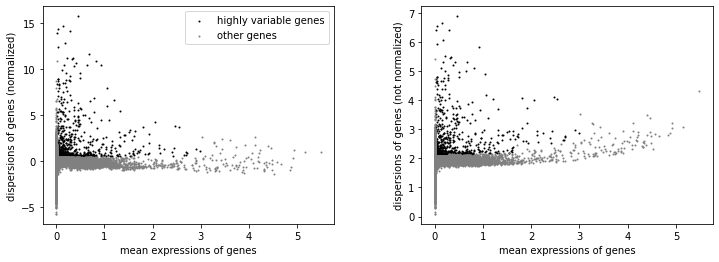

AnnData object with n_obs × n_vars = 30232 × 20764
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'sampleid_colors', 'patient_colors', 'sampletype_colors', 'leiden', 'group_colors', 'gender_colors', 'leiden_colors', 'rank_genes_groups', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

In [31]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['0', '9', '7', '4', '8', '6'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

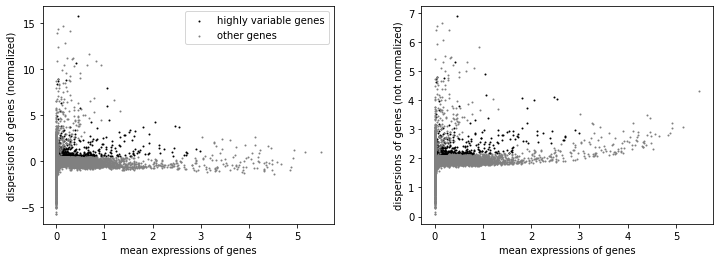

In [32]:
## remove TRBV/TRAV and IGHV/IGLV/IGKV from the highly variable genes
## allow for TRGV and TRDV so that i can do fine labelling for them
import re
for i in rna_x.var.index:
    if re.search('^TR[AB]V|^IG[HKL]V', i):
        rna_x.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(rna_x)

In [33]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

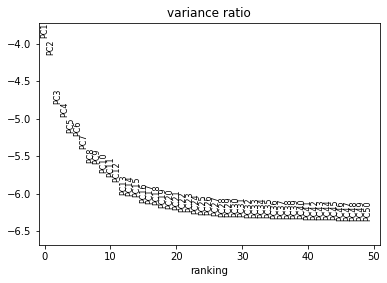

In [34]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

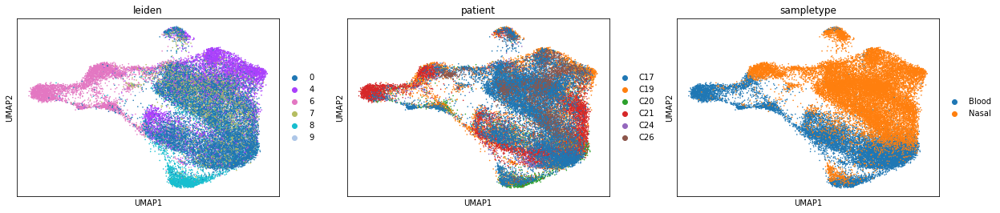

In [35]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient', neighbors_within_batch=10)
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'], size=10)

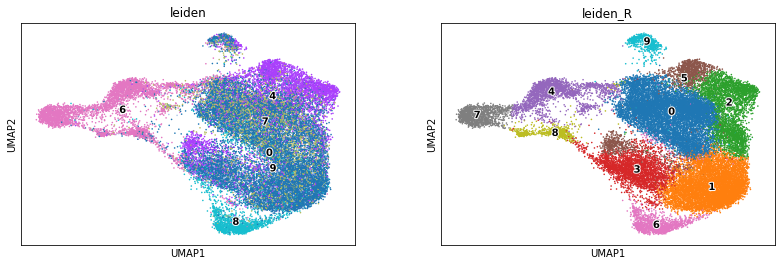

In [36]:
# find clusters
sc.tl.leiden(rna_x, resolution = .8, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=10, legend_loc ='on data', legend_fontoutline=2)

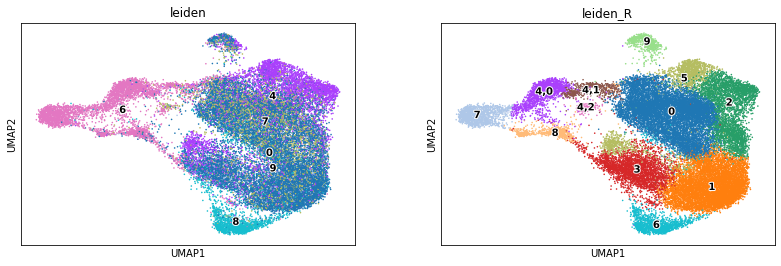

In [37]:
# find clusters
sc.tl.leiden(rna_x, resolution = .3, key_added = 'leiden_R', restrict_to =('leiden_R', ['4']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=10, legend_loc ='on data', legend_fontoutline=2)

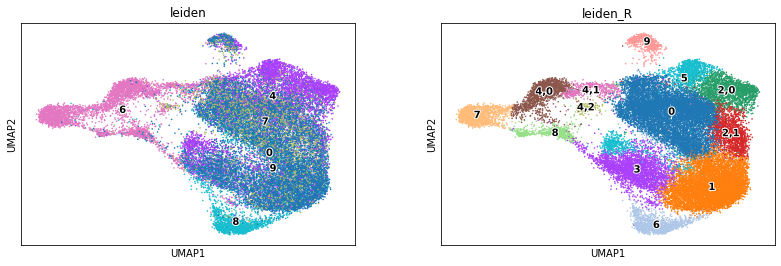

In [38]:
# find clusters
sc.tl.leiden(rna_x, resolution = .3, key_added = 'leiden_R', restrict_to =('leiden_R', ['2']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=10, legend_loc ='on data', legend_fontoutline=2)

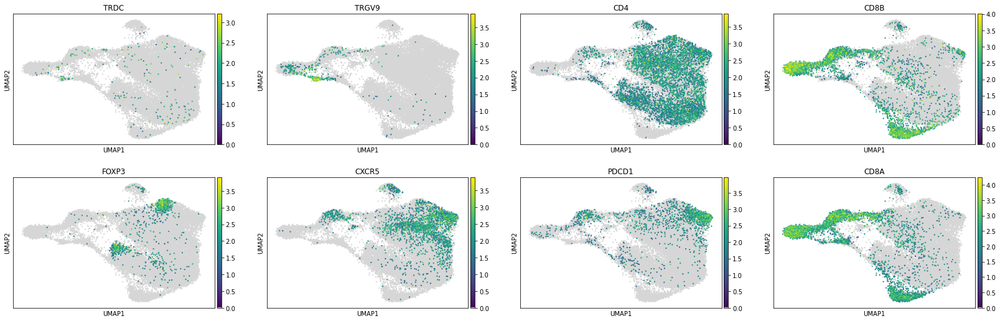

In [39]:
sc.pl.umap(rna_x, color = ['TRDC', 'TRGV9', 'CD4', 'CD8B', 'FOXP3', 'CXCR5', 'PDCD1', 'CD8A'], color_map = newcmp, size = 20)

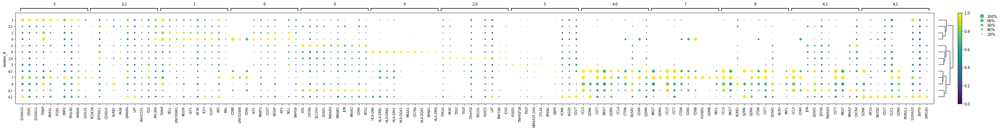

In [40]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'fine_label' as categorical


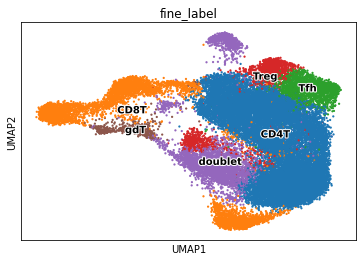

In [41]:
new_dict1 = {'0':'CD4T',
'1':'CD4T',
'2,0':'Tfh',
'2,1':'CD4T',
'3':'doublet',
'4,0':'CD8T',
'4,1':'CD8T',
'4,2':'doublet',
'5':'Treg',
'6':'CD8T',
'7':'CD8T',
'8':'gdT',
'9':'doublet'}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['fine_label'], size=20, legend_loc ='on data', legend_fontoutline=2)

... storing 'fine_label' as categorical


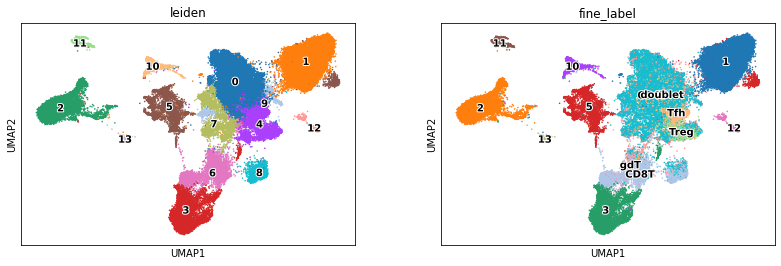

In [42]:
# update the original object
adata.obs['fine_label'] = adata.obs['fine_label'].astype('object')
adata.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'fine_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

### NK cell

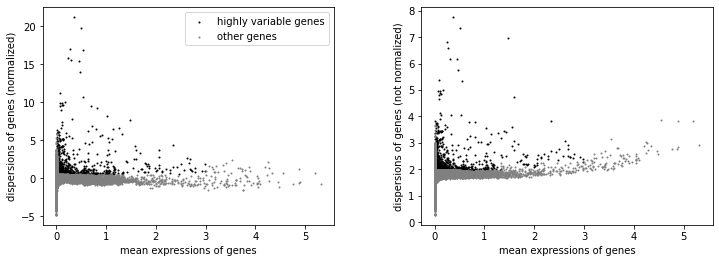

AnnData object with n_obs × n_vars = 5433 × 20764
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'sampleid_colors', 'patient_colors', 'sampletype_colors', 'leiden', 'group_colors', 'gender_colors', 'leiden_colors', 'rank_genes_groups', 'dendrogram_leiden', 'fine_label_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

In [43]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['3'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

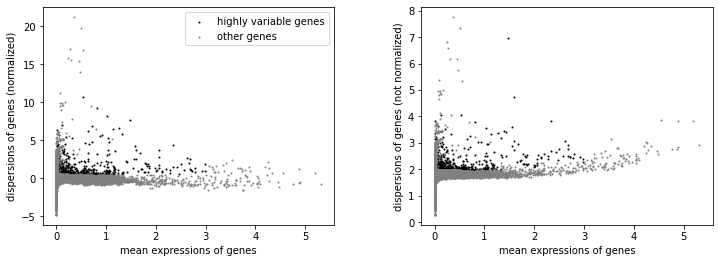

In [44]:
## remove TRBV/TRAV and IGHV/IGLV/IGKV from the highly variable genes
## collapse gamma deltas into a single cluster?
import re
for i in rna_x.var.index:
    if re.search('^TR[ABGD]V|^IG[HKL]V', i):
        rna_x.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(rna_x)

In [45]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

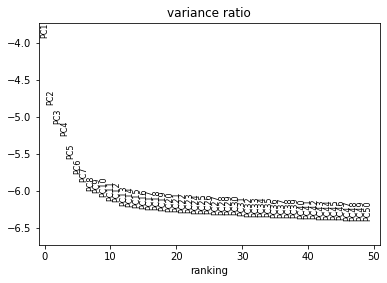

In [46]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

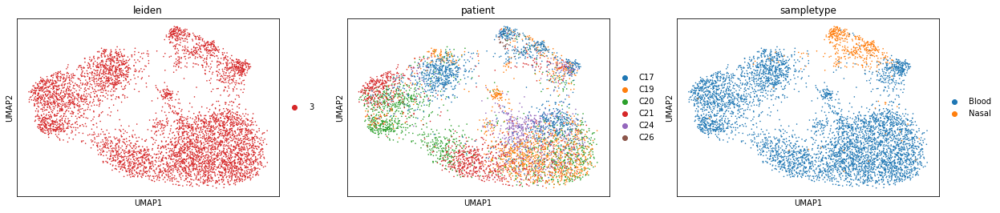

In [47]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient', neighbors_within_batch=10)
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'], size=10)

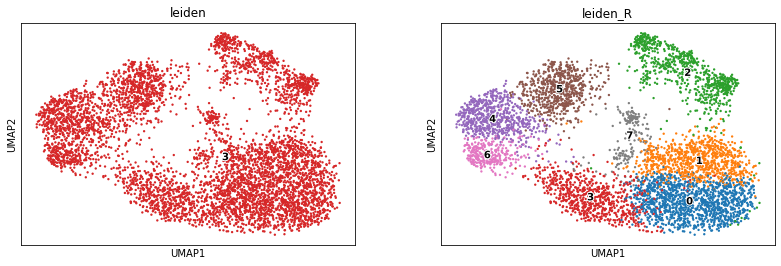

In [48]:
# find clusters
sc.tl.leiden(rna_x, resolution = 1, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], legend_loc ='on data', legend_fontoutline=2)

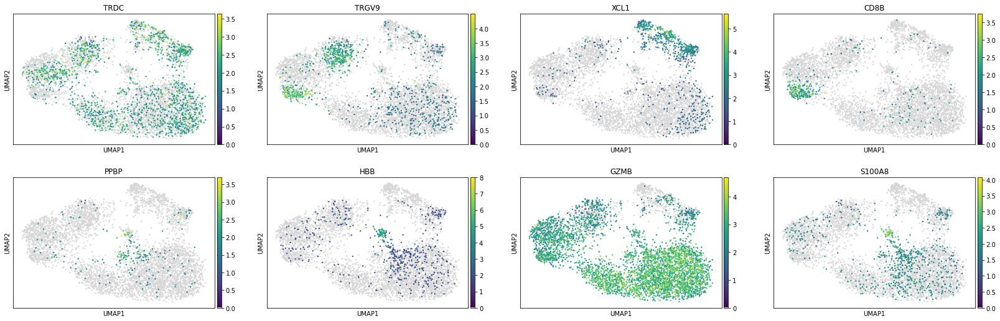

In [49]:
sc.pl.umap(rna_x, color = ['TRDC', 'TRGV9', 'XCL1', 'CD8B', 'PPBP', 'HBB', 'GZMB', 'S100A8'], color_map = newcmp)

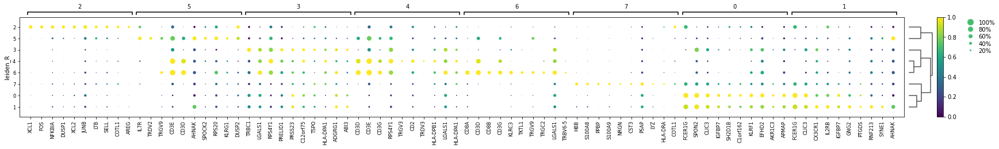

In [50]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'fine_label' as categorical


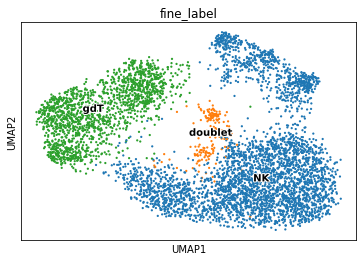

In [51]:
new_dict1 = {'0':'NK',
'1':'NK',
'2':'NK',
'3':'NK',
'4':'gdT',
'5':'gdT',
'6':'gdT',
'7':'doublet'}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['fine_label'], size=20, legend_loc ='on data', legend_fontoutline=2)

... storing 'fine_label' as categorical


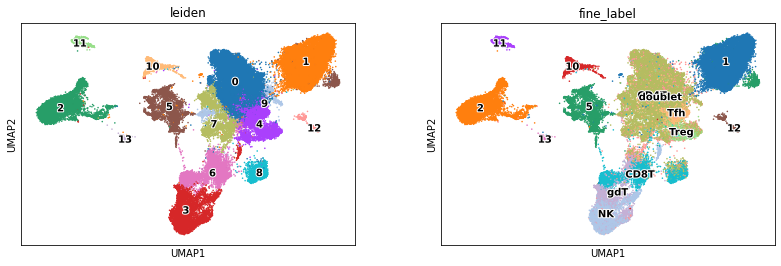

In [52]:
# update the original object
adata.obs['fine_label'] = adata.obs['fine_label'].astype('object')
adata.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'fine_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

### B cells

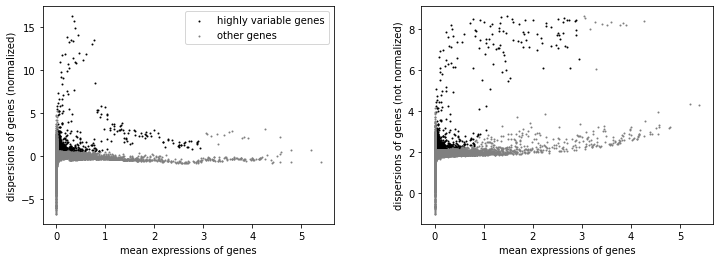

AnnData object with n_obs × n_vars = 16693 × 20764
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'sampleid_colors', 'patient_colors', 'sampletype_colors', 'leiden', 'group_colors', 'gender_colors', 'leiden_colors', 'rank_genes_groups', 'dendrogram_leiden', 'fine_label_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

In [53]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['1', '5'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

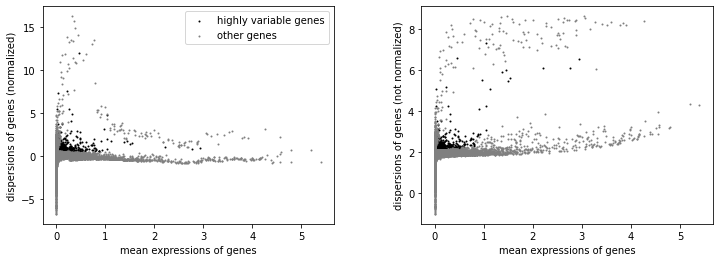

In [54]:
## remove TRBV/TRAV and IGHV/IGLV/IGKV from the highly variable genes
import re
for i in rna_x.var.index:
    if re.search('^TR[AB]V|^IG[HKL]V', i):
        rna_x.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(rna_x)

In [55]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

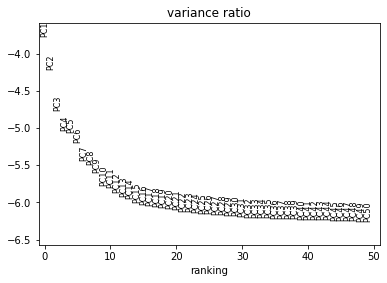

In [56]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

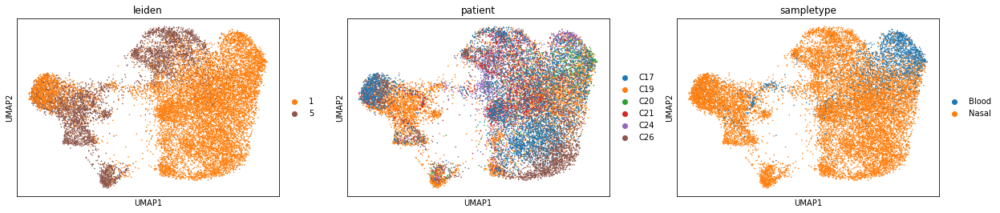

In [57]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient', neighbors_within_batch=10)
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'], size=10)

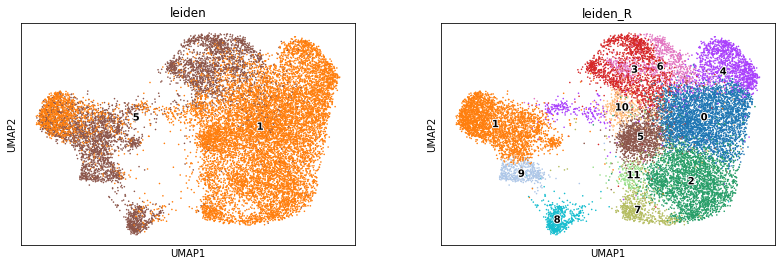

In [58]:
# find clusters
sc.tl.leiden(rna_x, resolution = 1, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=10, legend_loc ='on data', legend_fontoutline=2)

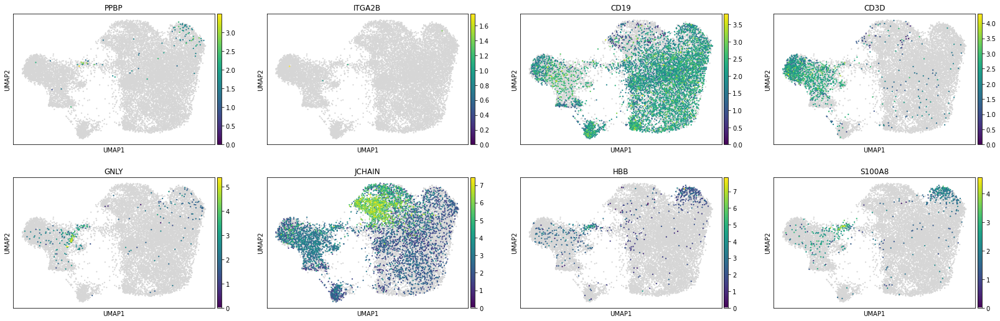

In [59]:
sc.pl.umap(rna_x, color = ['PPBP', 'ITGA2B', 'CD19', 'CD3D', 'GNLY', 'JCHAIN', 'HBB', 'S100A8'], color_map = newcmp, size = 20)

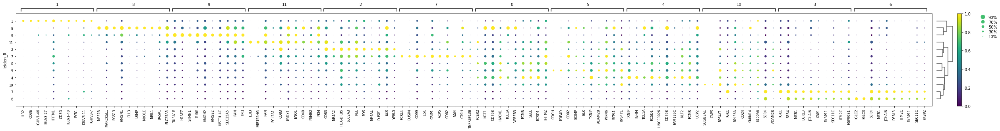

In [60]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'fine_label' as categorical


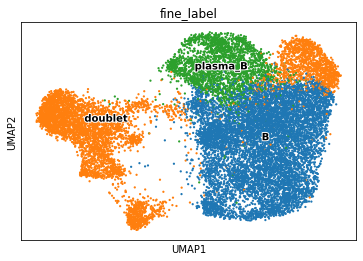

In [61]:
new_dict1 = {'0':'B',
'1':'doublet',
'2':'B',
'3':'plasma_B',
'4':'doublet',
'5':'B',
'6':'plasma_B',
'7':'B',
'8':'doublet',
'9':'doublet',
'10':'B',
'11':'B'}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['fine_label'], size=20, legend_loc ='on data', legend_fontoutline=2)

... storing 'fine_label' as categorical


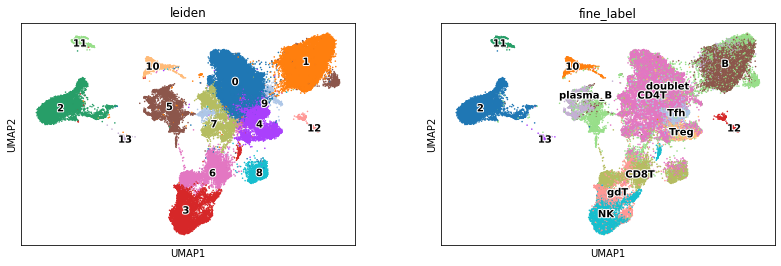

In [62]:
# update the original object
adata.obs['fine_label'] = adata.obs['fine_label'].astype('object')
adata.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'fine_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

### monocyte/macrophage/DC

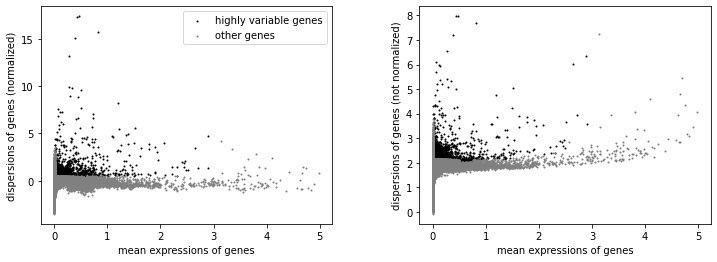

AnnData object with n_obs × n_vars = 6536 × 20764
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'sampleid_colors', 'patient_colors', 'sampletype_colors', 'leiden', 'group_colors', 'gender_colors', 'leiden_colors', 'rank_genes_groups', 'dendrogram_leiden', 'fine_label_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

In [63]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['2', '13'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [64]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

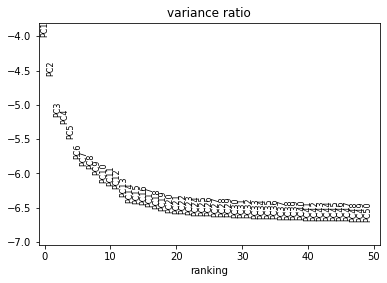

In [65]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

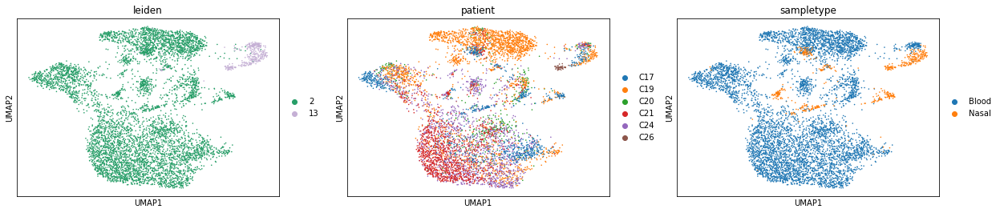

In [66]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient', neighbors_within_batch=10)
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'], size=10)

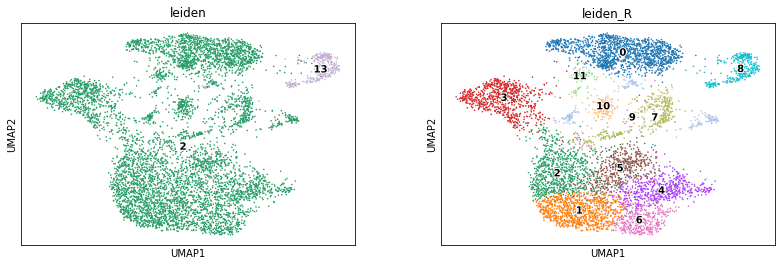

In [67]:
# find clusters
sc.tl.leiden(rna_x, resolution = 1, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=10, legend_loc ='on data', legend_fontoutline=2)

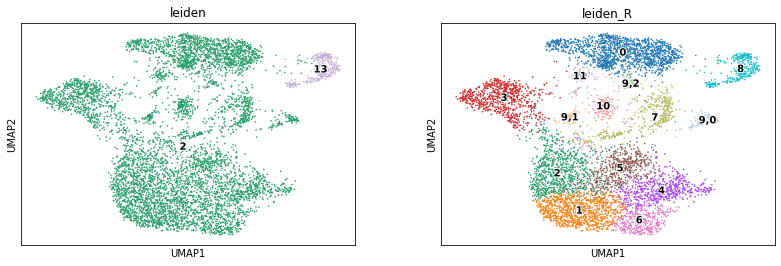

In [68]:
# find clusters
sc.tl.leiden(rna_x, resolution = .3, key_added = 'leiden_R', restrict_to = ('leiden_R', ['9']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=10, legend_loc ='on data', legend_fontoutline=2)

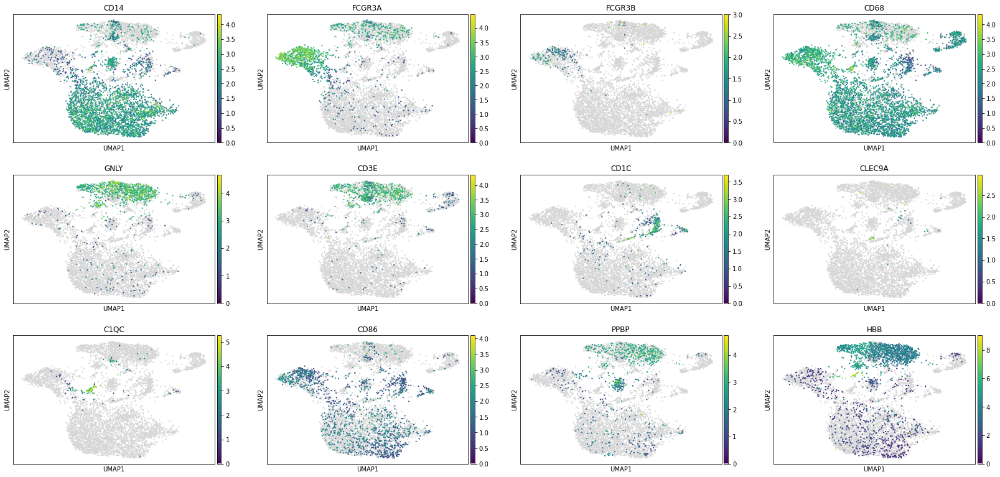

In [69]:
sc.pl.umap(rna_x, color = ['CD14', 'FCGR3A', 'FCGR3B', 'CD68', 'GNLY', 'CD3E', 'CD1C', 'CLEC9A', 'C1QC', 'CD86', 'PPBP', 'HBB'], color_map = newcmp, size = 20)

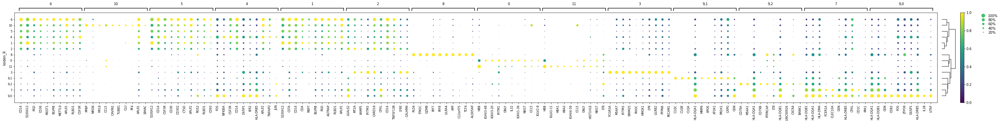

In [70]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'fine_label' as categorical


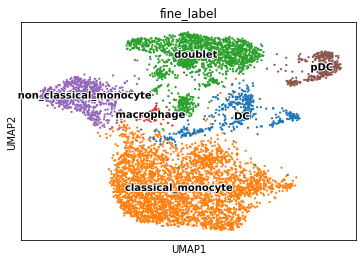

In [71]:
new_dict1 = {'0':'doublet',
'1':'classical_monocyte',
'2':'classical_monocyte',
'3':'non_classical_monocyte',
'4':'classical_monocyte',
'5':'classical_monocyte',
'6':'classical_monocyte',
'7':'DC',
'8':'pDC',
'9,0':'DC',
'9,1':'macrophage',
'9,2':'doublet',
'10':'doublet',
'11':'doublet'}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['fine_label'], size=20, legend_loc ='on data', legend_fontoutline=2)

... storing 'fine_label' as categorical


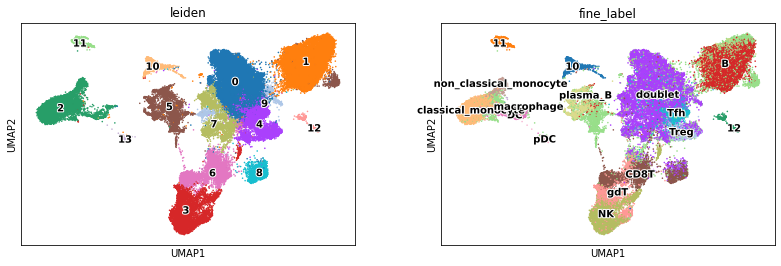

In [72]:
# update the original object
adata.obs['fine_label'] = adata.obs['fine_label'].astype('object')
adata.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'fine_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

### Megakaryocyte and erythrocyte

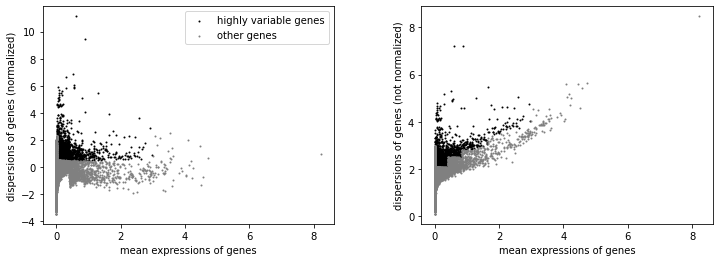

AnnData object with n_obs × n_vars = 1615 × 20764
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'sampleid_colors', 'patient_colors', 'sampletype_colors', 'leiden', 'group_colors', 'gender_colors', 'leiden_colors', 'rank_genes_groups', 'dendrogram_leiden', 'fine_label_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

In [73]:
# subset
rna_ = adata[adata.obs['leiden'].isin(['11', '10'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
sc.pl.highly_variable_genes(rna_x)
rna_x

In [74]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

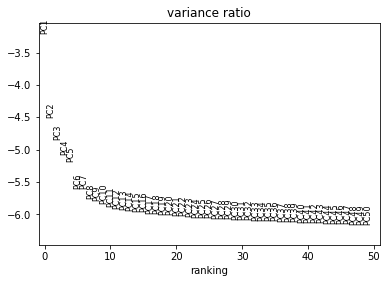

In [75]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

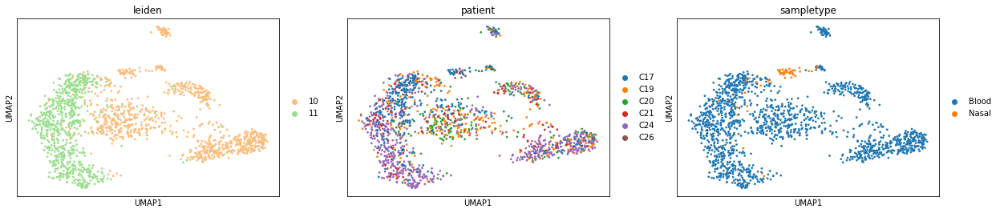

In [76]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient')
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['leiden', 'patient', 'sampletype'], size=30)

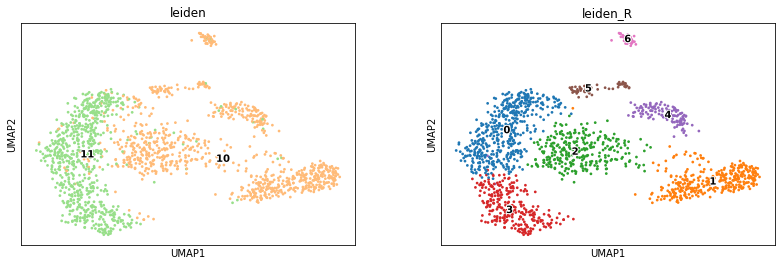

In [77]:
# find clusters
sc.tl.leiden(rna_x, resolution = .5, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=30, legend_loc ='on data', legend_fontoutline=2)

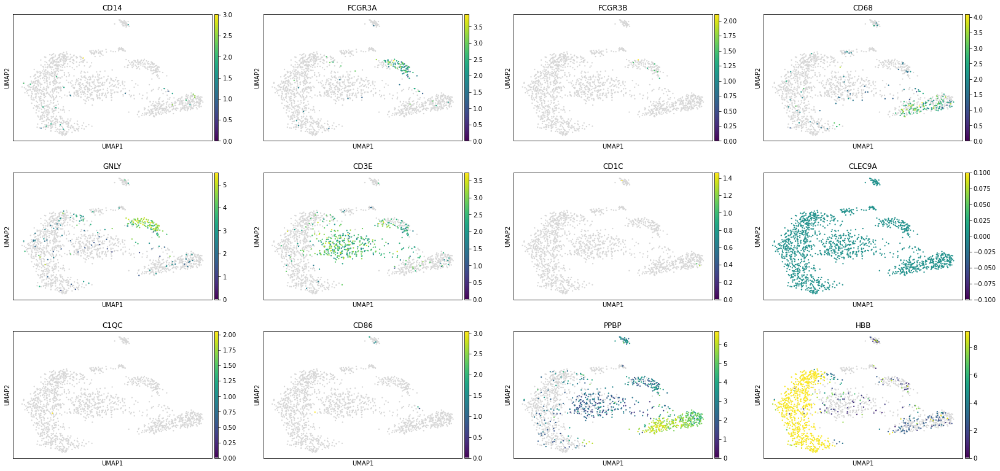

In [78]:
sc.pl.umap(rna_x, color = ['CD14', 'FCGR3A', 'FCGR3B', 'CD68', 'GNLY', 'CD3E', 'CD1C', 'CLEC9A', 'C1QC', 'CD86', 'PPBP', 'HBB'], color_map = newcmp, size = 20)

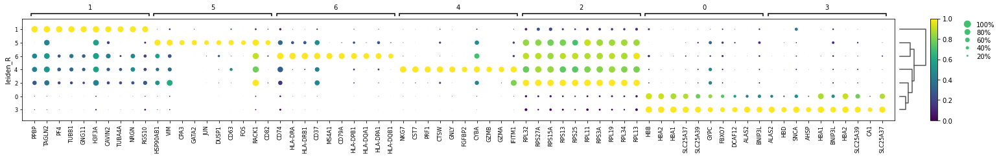

In [79]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'fine_label' as categorical


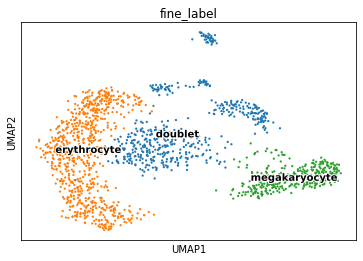

In [80]:
new_dict1 = {'0':'erythrocyte',
'1':'megakaryocyte',
'2':'doublet',
'3':'erythrocyte',
'4':'doublet',
'5':'doublet',
'6':'doublet'}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['fine_label'], size=20, legend_loc ='on data', legend_fontoutline=2)

... storing 'fine_label' as categorical


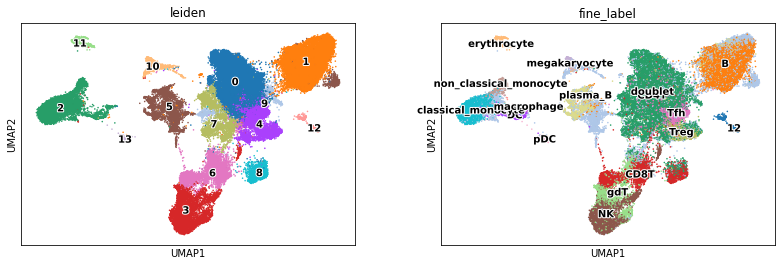

In [81]:
# update the original object
adata.obs['fine_label'] = adata.obs['fine_label'].astype('object')
adata.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))
sc.pl.umap(adata, color = ['leiden', 'fine_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

In [82]:
# transfer the slots in raw object
adata_raw.obs = adata.obs.copy()
adata_raw.obsm.update(adata.obsm)

In [83]:
# remove the doublets
adata = adata[~(adata.obs['fine_label'] == 'doublet')]
adata_raw = adata_raw[~(adata_raw.obs['fine_label'] == 'doublet')]
adata

View of AnnData object with n_obs × n_vars = 49205 × 746
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'sampleid_colors', 'patient_colors', 'sampletype_colors', 'leiden', 'group_colors', 'gender_colors', 'leiden_colors', 'rank_genes_groups', 'dendrogram_leiden', 'fine_label_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [84]:
# save this
adata.write('out/adata_control.h5ad', compression = 'gzip')
adata_raw.write('out/adata_control_raw.h5ad', compression = 'gzip')

Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical


### Re-cluster the object without doublets

In [85]:
# recluster
adata2 = sc.AnnData(X = adata.raw.X, var = adata.raw.var, obs = adata.obs, raw = adata.raw)
adata2

AnnData object with n_obs × n_vars = 49205 × 20764
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells'

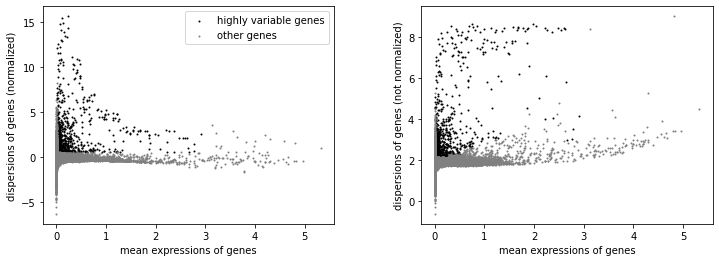

In [86]:
# Identify highly-variable genes
sc.pp.highly_variable_genes(adata2, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
# plot highly_variable_genes
sc.pl.highly_variable_genes(adata2)

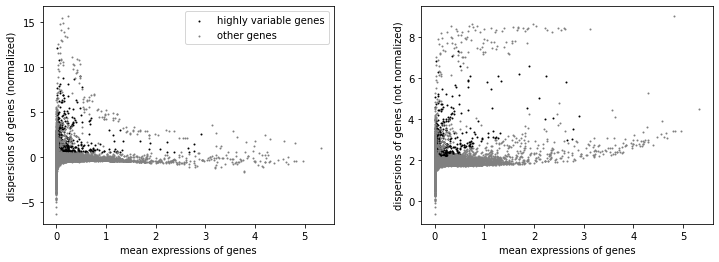

In [87]:
## remove TRBV/TRAV/TRDV/TRGV and IGHV/IGLV/IGKV from the highly variable genes
import re
for i in adata2.var.index:
    if re.search('^TR[ABGD]V|^IG[HKL]V', i):
        adata2.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(adata2)

In [88]:
# filter to only highly variable
adata2 = adata2[:, adata2.var['highly_variable']]
adata2

View of AnnData object with n_obs × n_vars = 49205 × 783
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'

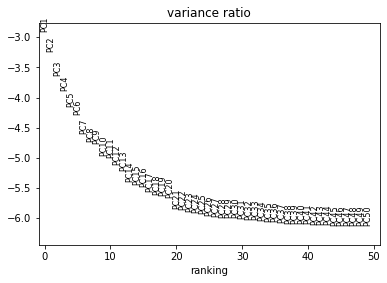

In [89]:
import multiprocessing
# regress and scale for PCA
sc.pp.regress_out(adata2, ['n_counts', 'percent_mito'], n_jobs = multiprocessing.cpu_count()-4)
sc.pp.scale(adata2, max_value = 10)
# Principal component analysis
sc.tl.pca(adata2, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(adata2, log = True, n_pcs = 50)

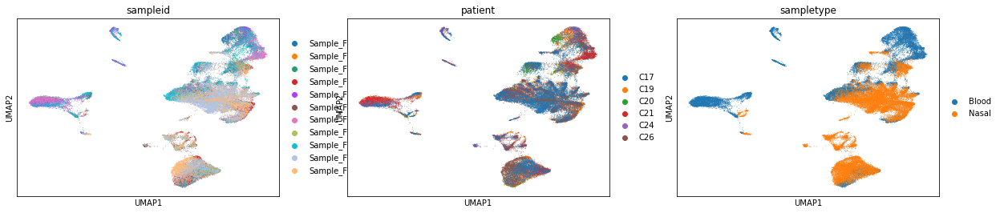

In [90]:
# run BBKNN
sc.external.pp.bbknn(adata2, batch_key = 'patient', neighbors_within_batch=10)
# UMAP
sc.tl.umap(adata2, n_components = 2, min_dist = 0.3)
sc.pl.umap(adata2, color=['sampleid', 'patient', 'sampletype'])

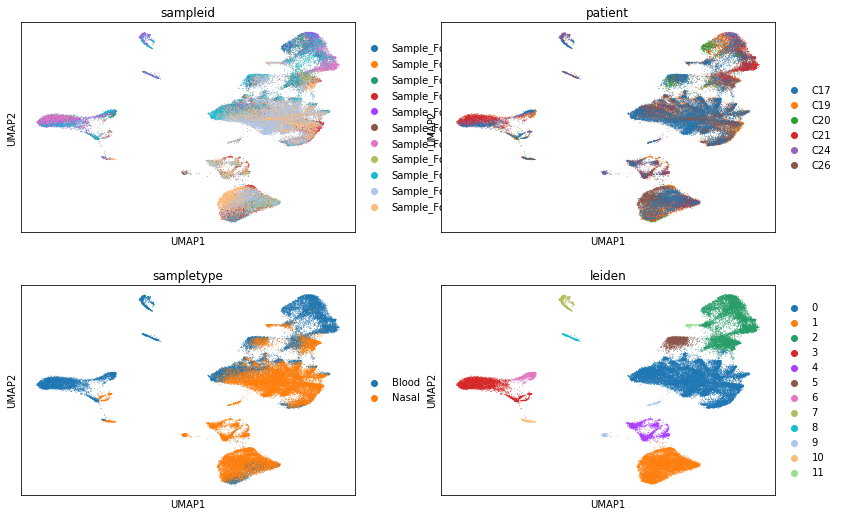

In [91]:
# find clusters
sc.tl.leiden(adata2, resolution = 0.3)
sc.pl.umap(adata2, color=['sampleid', 'patient', 'sampletype', 'leiden'], ncols = 2)

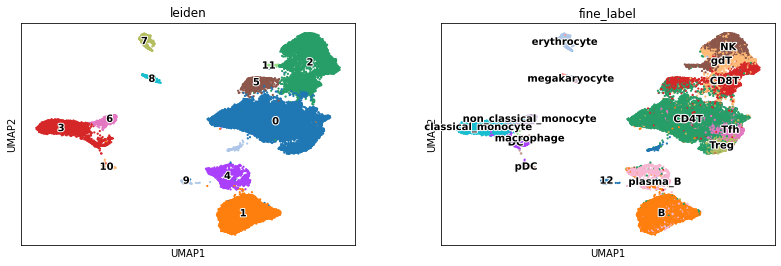

In [92]:
sc.pl.umap(adata2, color=['leiden', 'fine_label'], size = 20, legend_loc = 'on data', legend_fontoutline=2)

### Clean up annotations

### CD4 T

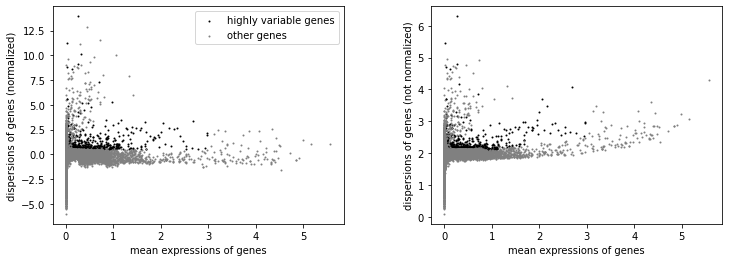

AnnData object with n_obs × n_vars = 20903 × 20764
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'pca', 'neighbors', 'umap', 'sampleid_colors', 'patient_colors', 'sampletype_colors', 'leiden', 'leiden_colors', 'fine_label_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

In [93]:
# subset
rna_ = adata2[adata2.obs['leiden'].isin(['0'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
## remove TRBV/TRAV and IGHV/IGLV/IGKV from the highly variable genes
import re
for i in rna_x.var.index:
    if re.search('^TR[AB]V|^IG[HKL]V', i):
        rna_x.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(rna_x)
rna_x

In [94]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

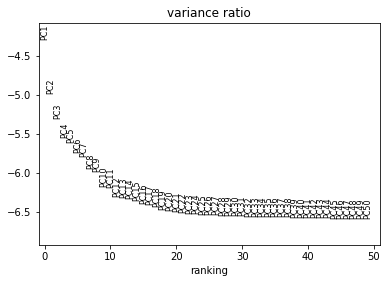

In [95]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

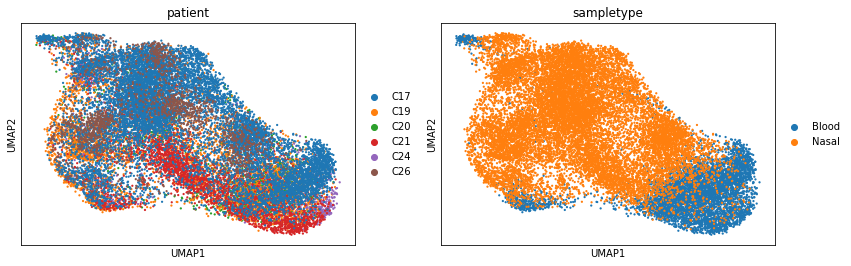

In [96]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient', neighbors_within_batch=10)
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['patient', 'sampletype'], size=20)

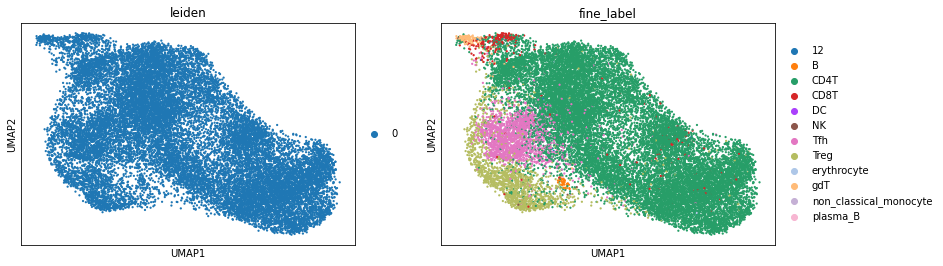

In [97]:
sc.pl.umap(rna_x, color=['leiden', 'fine_label'], size=20)

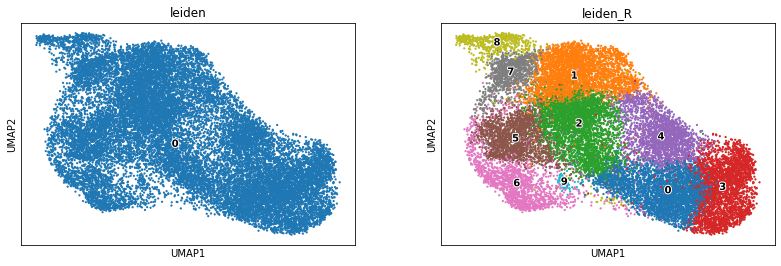

In [98]:
# find clusters
sc.tl.leiden(rna_x, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=20, legend_loc ='on data', legend_fontoutline=2)

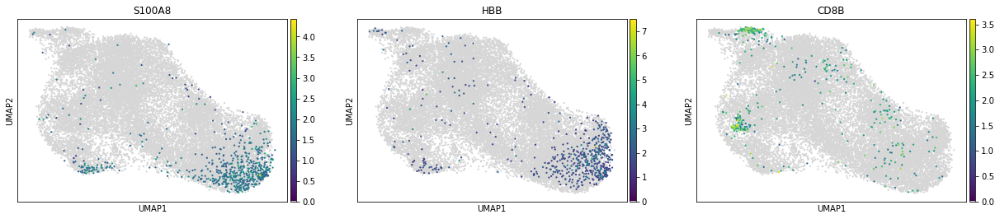

In [99]:
sc.pl.umap(rna_x, color=['S100A8', 'HBB', 'CD8B'], size=20, color_map = newcmp)

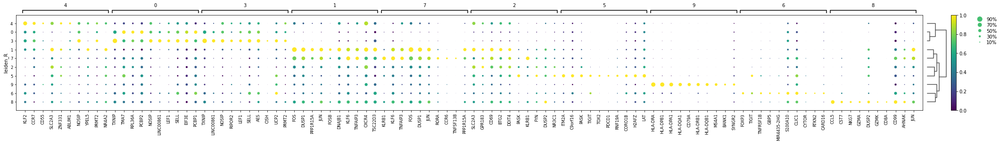

In [100]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'fine_label' as categorical


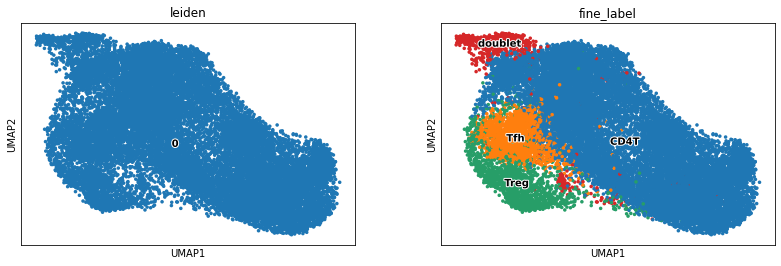

In [101]:
new_dict1 = {'0':'CD4T',
'1':'CD4T',
'2':'CD4T',
'3':'CD4T',
'4':'CD4T',
'5':'Tfh',
'6':'Treg',
'7':'CD4T',
'8':'doublet',
'9':'doublet'}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['leiden', 'fine_label'], size=50, legend_loc ='on data', legend_fontoutline=2)

... storing 'fine_label' as categorical


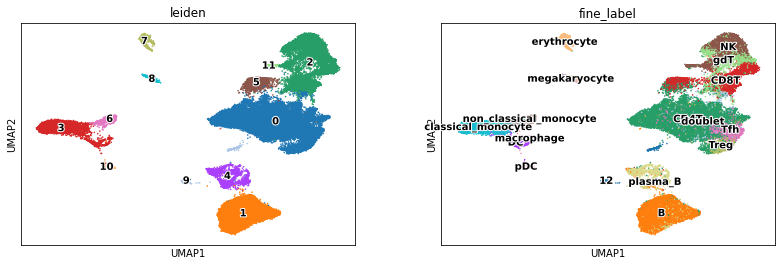

In [102]:
# update the original object
adata2.obs['fine_label'] = adata2.obs['fine_label'].astype('object')
adata2.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))
sc.pl.umap(adata2, color = ['leiden', 'fine_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

### CD8T, NK and gdT

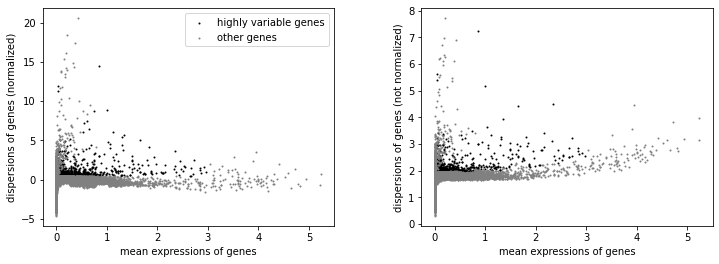

AnnData object with n_obs × n_vars = 10742 × 20764
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'pca', 'neighbors', 'umap', 'sampleid_colors', 'patient_colors', 'sampletype_colors', 'leiden', 'leiden_colors', 'fine_label_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

In [103]:
# subset
rna_ = adata2[adata2.obs['leiden'].isin(['5','11','2'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
## remove TRBV/TRAV and IGHV/IGLV/IGKV from the highly variable genes
import re
for i in rna_x.var.index:
    if re.search('^TR[AB]V|^IG[HKL]V', i):
        rna_x.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(rna_x)
rna_x

In [104]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

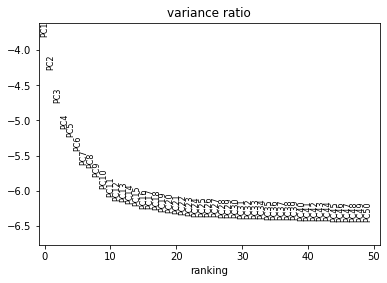

In [105]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

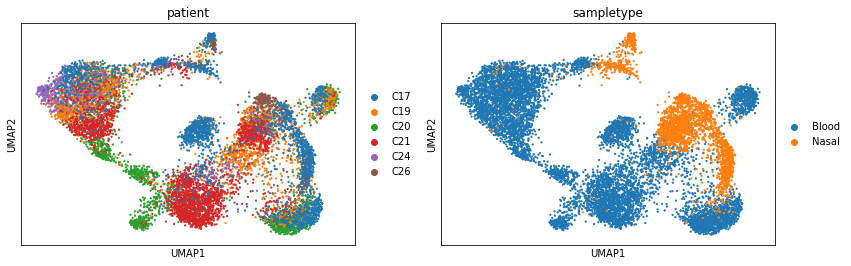

In [106]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient', neighbors_within_batch=10)
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['patient', 'sampletype'], size=20)

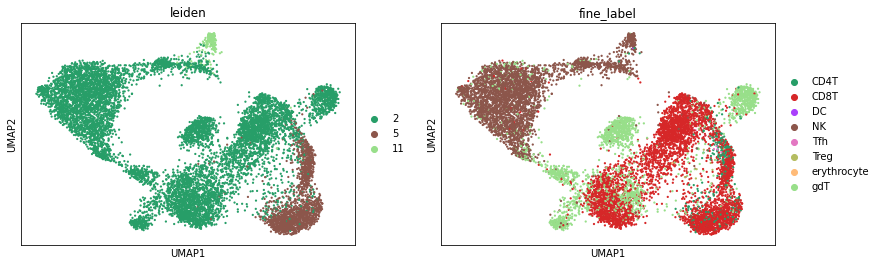

In [107]:
sc.pl.umap(rna_x, color=['leiden', 'fine_label'], size=20)

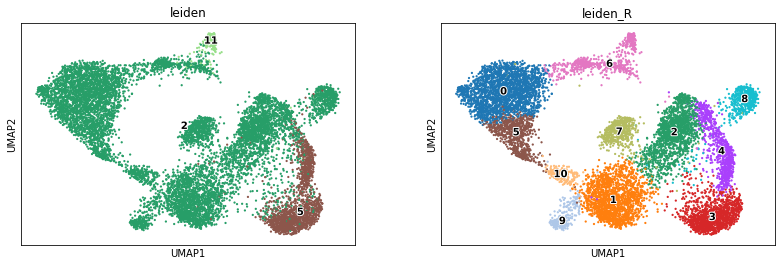

In [108]:
# find clusters
sc.tl.leiden(rna_x, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=20, legend_loc ='on data', legend_fontoutline=2)

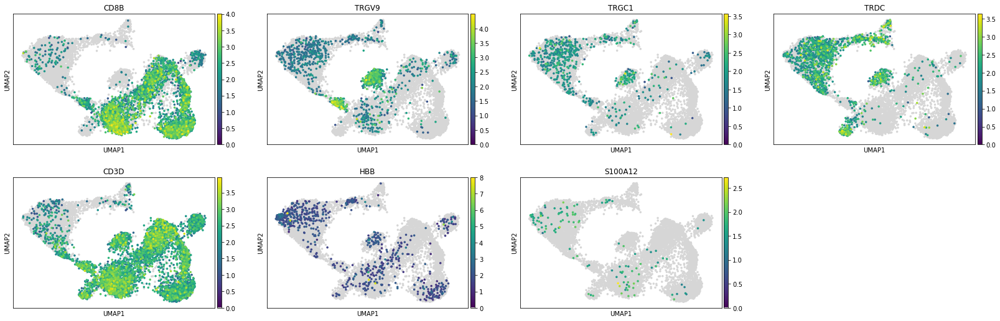

In [109]:
sc.pl.umap(rna_x, color=['CD8B', 'TRGV9', 'TRGC1', 'TRDC', 'CD3D', 'HBB', 'S100A12'], color_map = newcmp, size =50)

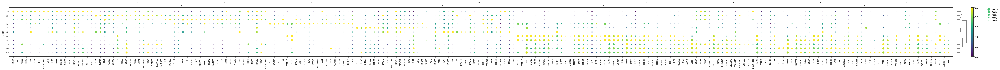

In [110]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 20, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

In [111]:
rna_x2 = rna_x.copy()
for i in rna_x2.var.index:
    if re.search('^TR[ABGD]V|^IG[HKL]V', i):
        rna_x2.var.at[i, 'highly_variable'] = False

In [112]:
# subset to highly variable
rna_x2 = rna_x2[:, rna_x2.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x2, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x2, max_value = 10)

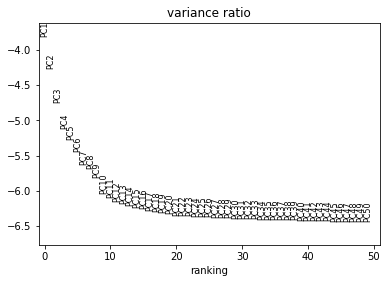

In [113]:
# Principal component analysis
sc.tl.pca(rna_x2, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x2, log = True, n_pcs = 50)

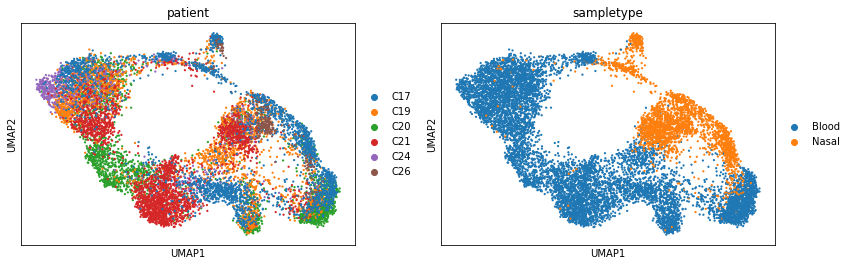

In [114]:
# run BBKNN
sc.external.pp.bbknn(rna_x2, batch_key = 'patient', neighbors_within_batch=10)
# UMAP
sc.tl.umap(rna_x2, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x2, color=['patient', 'sampletype'], size=20)

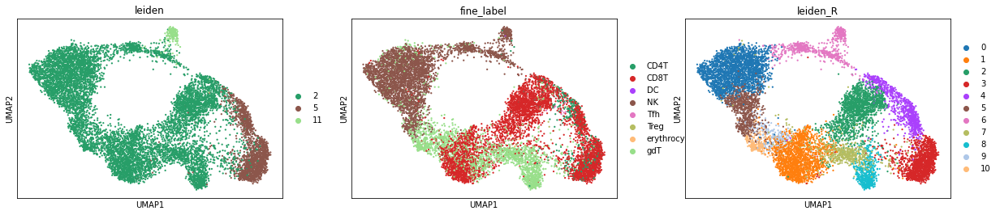

In [115]:
sc.pl.umap(rna_x2, color=['leiden', 'fine_label', 'leiden_R'], size=20)

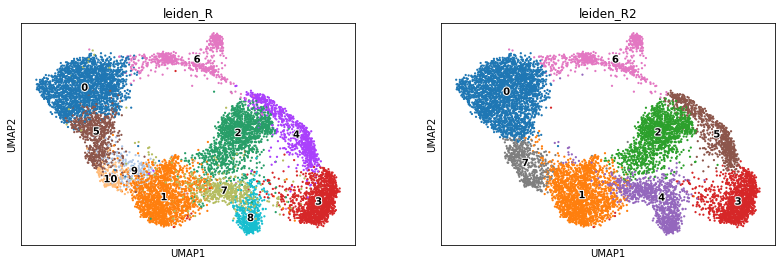

In [116]:
# find clusters
sc.tl.leiden(rna_x2, key_added = 'leiden_R2')
sc.pl.umap(rna_x2, color=['leiden_R', 'leiden_R2'], size=20, legend_loc ='on data', legend_fontoutline=2)

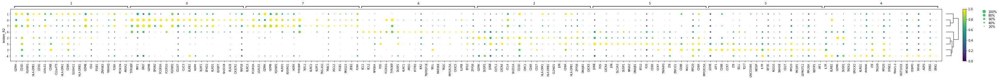

In [117]:
sc.tl.rank_genes_groups(rna_x2, groupby = 'leiden_R2', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x2, min_fold_change=1)
sc.tl.dendrogram(rna_x2, groupby = 'leiden_R2')
sc.pl.rank_genes_groups_dotplot(rna_x2, n_genes = 20, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

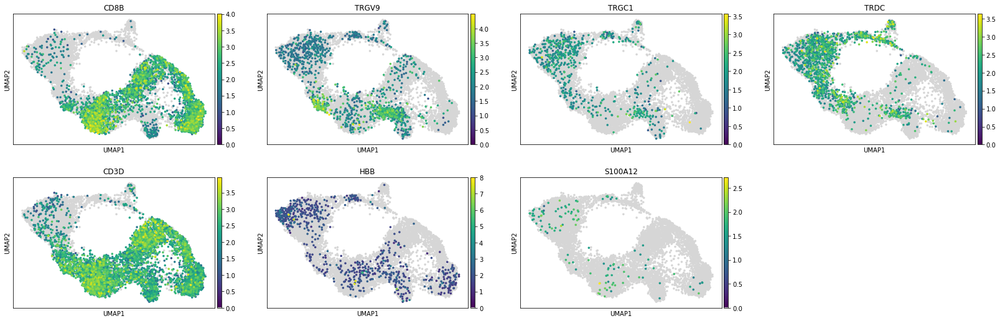

In [118]:
sc.pl.umap(rna_x2, color=['CD8B', 'TRGV9', 'TRGC1', 'TRDC', 'CD3D', 'HBB', 'S100A12'], color_map = newcmp, size =50)

... storing 'fine_label' as categorical


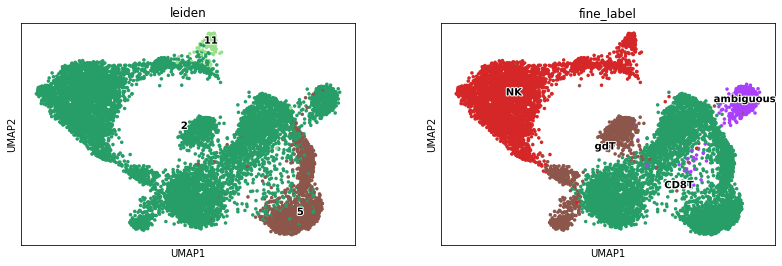

In [119]:
new_dict1 = {'0':'NK',
'1':'CD8T',
'2':'CD8T',
'3':'CD8T',
'4':'CD8T',
'5':'NK',
'6':'NK',
'7':'gdT',
'8':'ambiguous',
'9':'gdT',
'10':'gdT',}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['leiden', 'fine_label'], size=50, legend_loc ='on data', legend_fontoutline=2)

... storing 'fine_label' as categorical


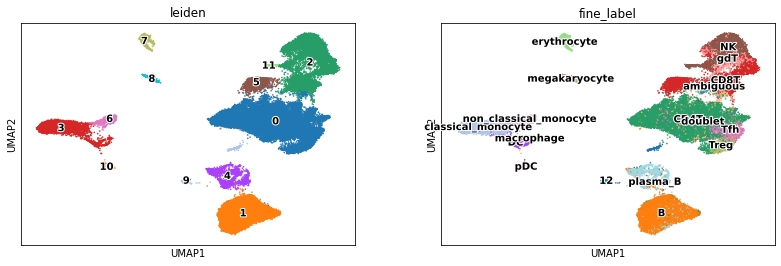

In [120]:
# update the original object
adata2.obs['fine_label'] = adata2.obs['fine_label'].astype('object')
adata2.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))
sc.pl.umap(adata2, color = ['leiden', 'fine_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

### myeloid

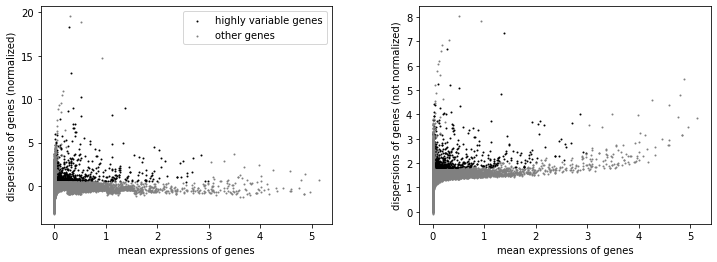

AnnData object with n_obs × n_vars = 4839 × 20764
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'pca', 'neighbors', 'umap', 'sampleid_colors', 'patient_colors', 'sampletype_colors', 'leiden', 'leiden_colors', 'fine_label_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

In [121]:
# subset
rna_ = adata2[adata2.obs['leiden'].isin(['3','10', '6'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
## remove TRBV/TRAV and IGHV/IGLV/IGKV from the highly variable genes
import re
for i in rna_x.var.index:
    if re.search('^TR[AB]V|^IG[HKL]V', i):
        rna_x.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(rna_x)
rna_x

In [122]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

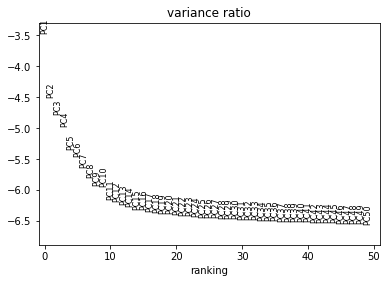

In [123]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

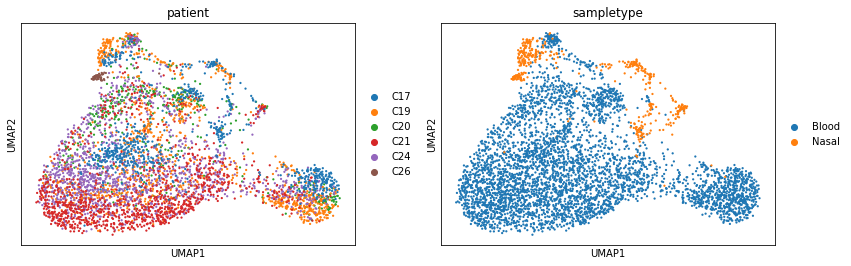

In [124]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient', neighbors_within_batch=10)
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['patient', 'sampletype'], size=20)

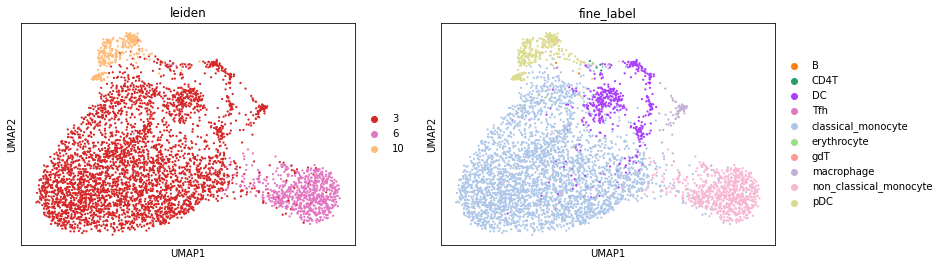

In [125]:
sc.pl.umap(rna_x, color=['leiden', 'fine_label'], size=20)

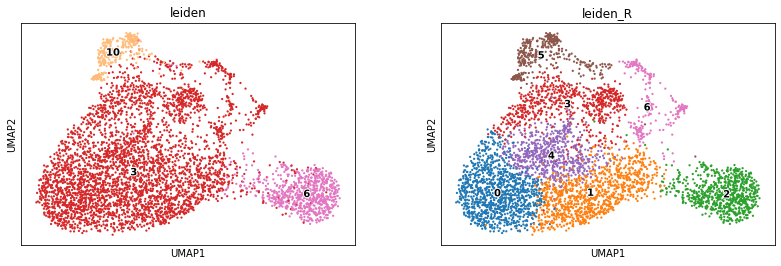

In [126]:
# find clusters
sc.tl.leiden(rna_x, key_added = 'leiden_R', resolution = 0.8)
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=20, legend_loc ='on data', legend_fontoutline=2)

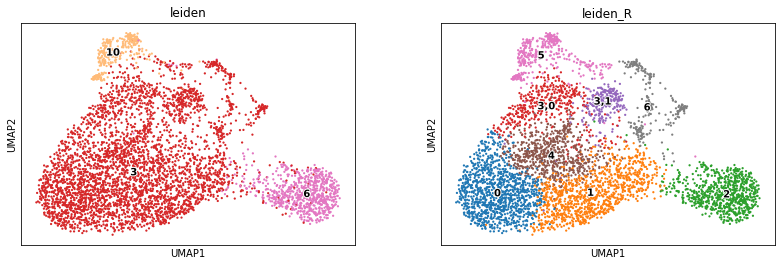

In [127]:
sc.tl.leiden(rna_x, key_added = 'leiden_R', resolution = 0.5, restrict_to =('leiden_R', ['3']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=20, legend_loc ='on data', legend_fontoutline=2)

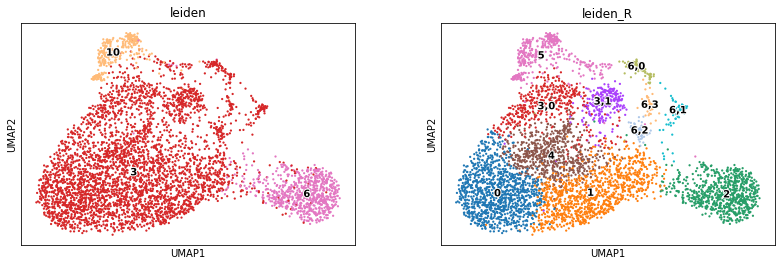

In [128]:
sc.tl.leiden(rna_x, key_added = 'leiden_R', resolution = 0.5, restrict_to =('leiden_R', ['6']))
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=20, legend_loc ='on data', legend_fontoutline=2)

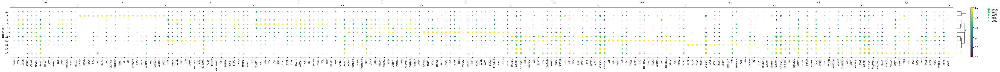

In [129]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 20, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'fine_label' as categorical


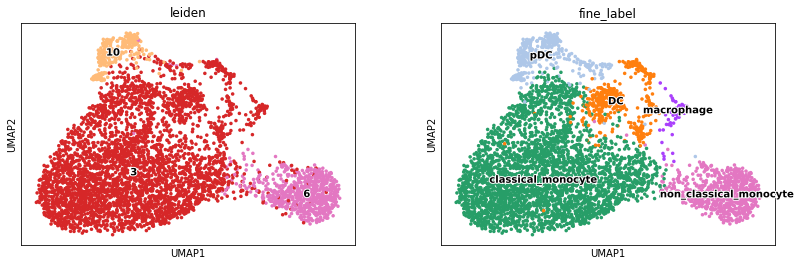

In [130]:
new_dict1 = {'0':'classical_monocyte',
'1':'classical_monocyte',
'2':'non_classical_monocyte',
'3,0':'classical_monocyte',
'3,1':'DC',
'4':'classical_monocyte',
'5':'pDC',
'6,0':'DC',
'6,1':'macrophage',
'6,2':'DC',
'6,3':'DC'}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['leiden', 'fine_label'], size=50, legend_loc ='on data', legend_fontoutline=2)

... storing 'fine_label' as categorical


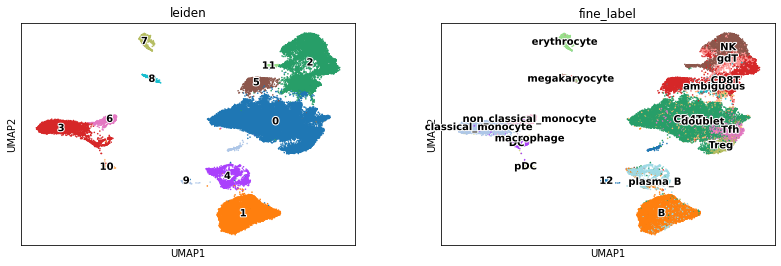

In [131]:
# update the original object
adata2.obs['fine_label'] = adata2.obs['fine_label'].astype('object')
adata2.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))
sc.pl.umap(adata2, color = ['leiden', 'fine_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

### epithelial

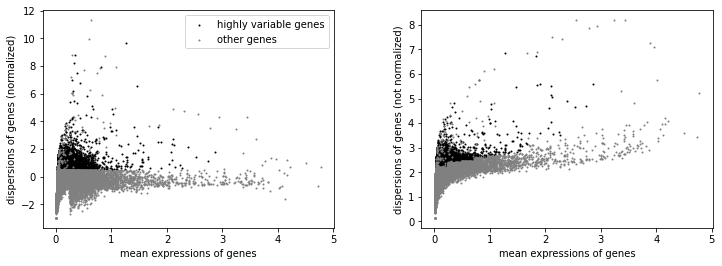

AnnData object with n_obs × n_vars = 371 × 20764
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'pca', 'neighbors', 'umap', 'sampleid_colors', 'patient_colors', 'sampletype_colors', 'leiden', 'leiden_colors', 'fine_label_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

In [132]:
# subset
rna_ = adata2[adata2.obs['leiden'].isin(['9'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
## remove TRBV/TRAV and IGHV/IGLV/IGKV from the highly variable genes
import re
for i in rna_x.var.index:
    if re.search('^TR[AB]V|^IG[HKL]V', i):
        rna_x.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(rna_x)
rna_x

In [133]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

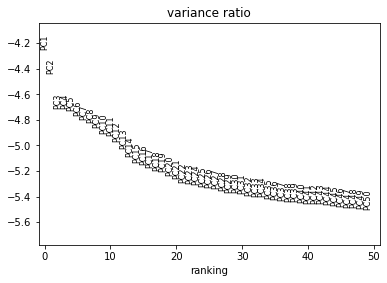

In [134]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

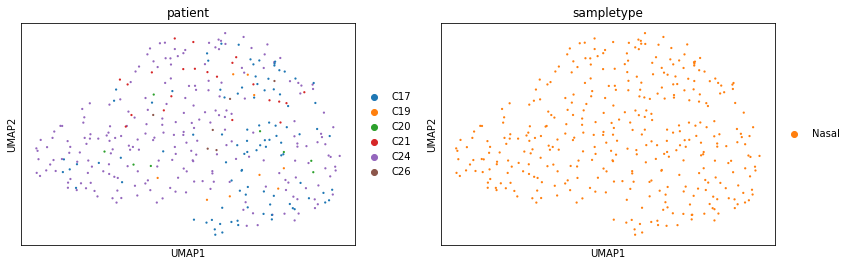

In [135]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient')
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['patient', 'sampletype'], size=20)

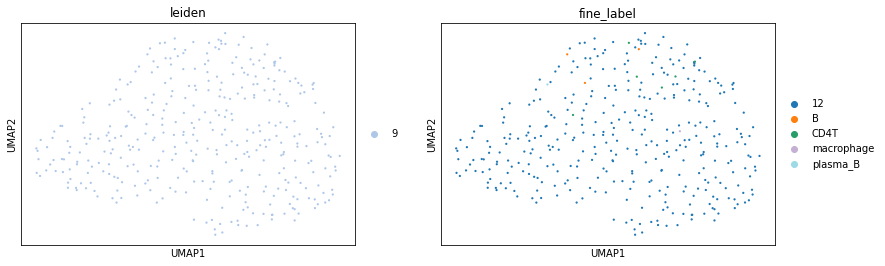

In [136]:
sc.pl.umap(rna_x, color=['leiden', 'fine_label'], size=20)

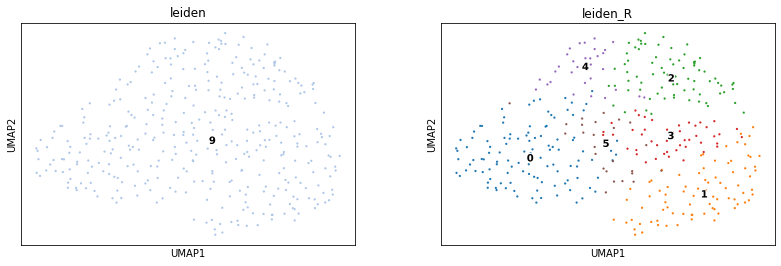

In [137]:
# find clusters
sc.tl.leiden(rna_x, key_added = 'leiden_R')
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=20, legend_loc ='on data', legend_fontoutline=2)

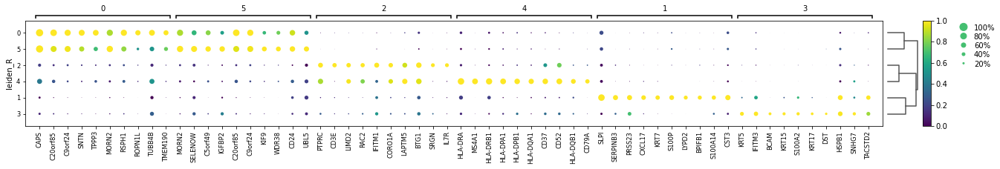

In [138]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

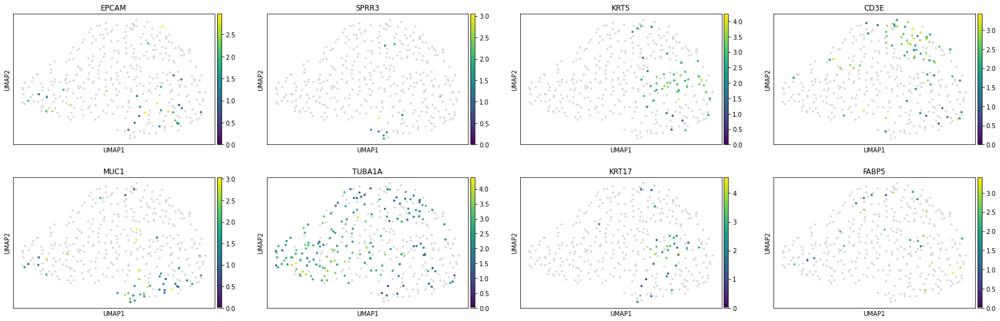

In [139]:
sc.pl.umap(rna_x, color = ['EPCAM', 'SPRR3', 'KRT5', 'CD3E', 'MUC1', 'TUBA1A', 'KRT17', 'FABP5'], color_map = newcmp, size = 50)

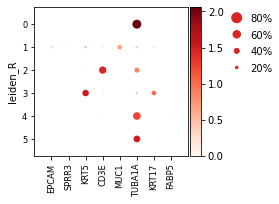

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[2.8, 0, 0.2, 0.5, 0.25])

In [140]:
sc.pl.dotplot(rna_x,['EPCAM', 'SPRR3', 'KRT5', 'CD3E', 'MUC1', 'TUBA1A', 'KRT17', 'FABP5'], groupby = 'leiden_R')

... storing 'fine_label' as categorical


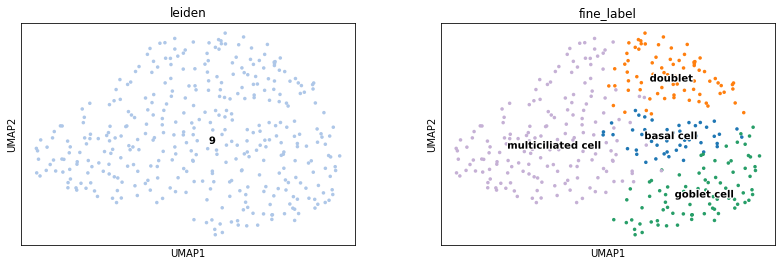

In [141]:
new_dict1 = {'0':'multiciliated cell',
'1':'goblet cell',
'2':'doublet',
'3':'basal cell',
'4':'multiciliated cell',
'5':'multiciliated cell'}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden_R']]
sc.pl.umap(rna_x, color=['leiden', 'fine_label'], size=50, legend_loc ='on data', legend_fontoutline=2)

... storing 'fine_label' as categorical


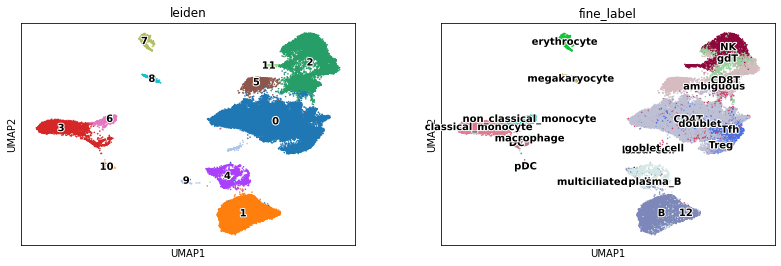

In [142]:
# update the original object
adata2.obs['fine_label'] = adata2.obs['fine_label'].astype('object')
adata2.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))
sc.pl.umap(adata2, color = ['leiden', 'fine_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

### B

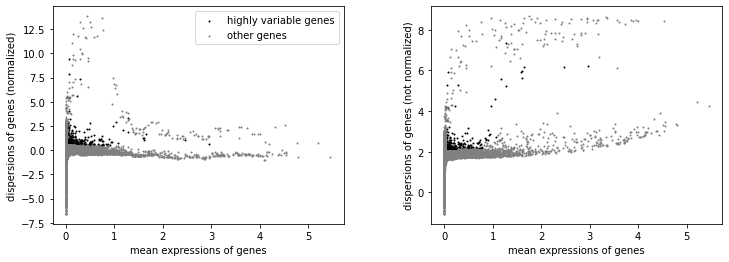

AnnData object with n_obs × n_vars = 11250 × 20764
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'pca', 'neighbors', 'umap', 'sampleid_colors', 'patient_colors', 'sampletype_colors', 'leiden', 'leiden_colors', 'fine_label_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'distances', 'connectivities'

In [143]:
# subset
rna_ = adata2[adata2.obs['leiden'].isin(['1', '4'])]
rna_x = sc.AnnData(X = rna_.raw.X, obs = rna_.obs, var = rna_.raw.var, uns = rna_.uns, obsm = rna_.obsm, obsp = rna_.obsp)
rna_x.raw = rna_x
sc.pp.highly_variable_genes(rna_x, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
## remove TRBV/TRAV and IGHV/IGLV/IGKV from the highly variable genes
import re
for i in rna_x.var.index:
    if re.search('^TR[AB]V|^IG[HKL]V', i):
        rna_x.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(rna_x)
rna_x

In [144]:
# subset to highly variable
rna_x = rna_x[:, rna_x.var['highly_variable']]
# regress and scale for PCA
sc.pp.regress_out(rna_x, ['n_counts', 'percent_mito'])
sc.pp.scale(rna_x, max_value = 10)

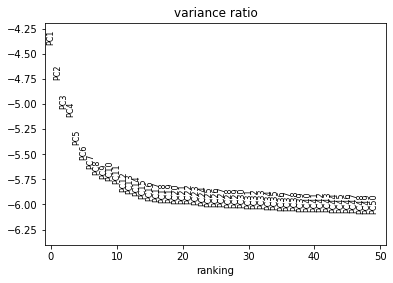

In [145]:
# Principal component analysis
sc.tl.pca(rna_x, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(rna_x, log = True, n_pcs = 50)

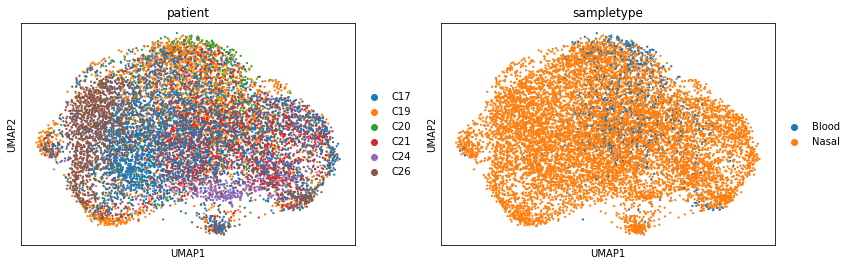

In [146]:
# run BBKNN
sc.external.pp.bbknn(rna_x, batch_key = 'patient', neighbors_within_batch=10)
# UMAP
sc.tl.umap(rna_x, n_components = 2, min_dist = 0.3)
sc.pl.umap(rna_x, color=['patient', 'sampletype'], size=20)

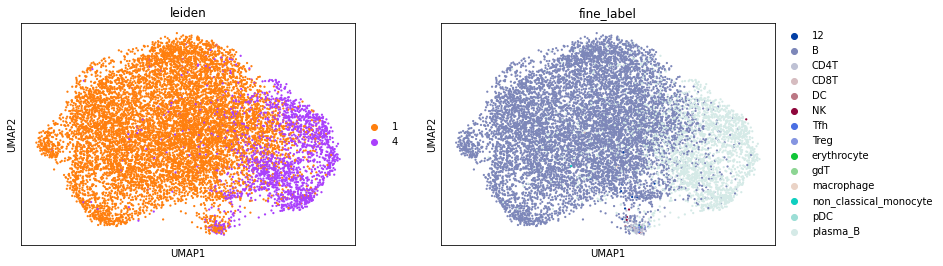

In [147]:
sc.pl.umap(rna_x, color=['leiden', 'fine_label'], size=20)

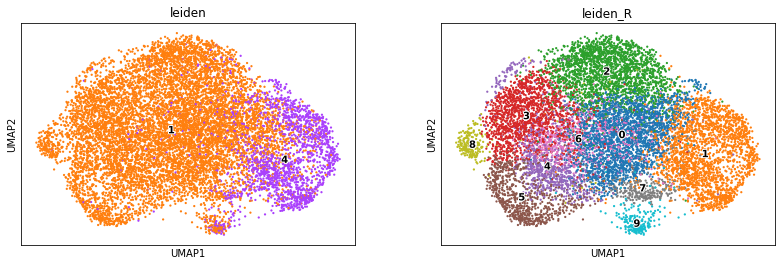

In [148]:
# find clusters
sc.tl.leiden(rna_x, key_added = 'leiden_R', resolution = 0.8)
sc.pl.umap(rna_x, color=['leiden', 'leiden_R'], size=20, legend_loc ='on data', legend_fontoutline=2)

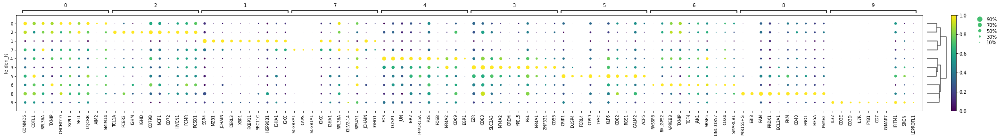

In [149]:
sc.tl.rank_genes_groups(rna_x, groupby = 'leiden_R', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(rna_x, min_fold_change=1)
sc.tl.dendrogram(rna_x, groupby = 'leiden_R')
sc.pl.rank_genes_groups_dotplot(rna_x, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'fine_label' as categorical


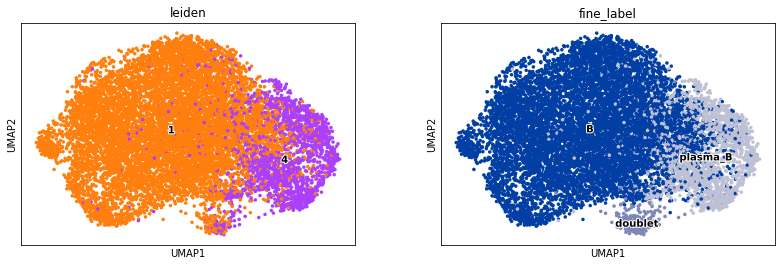

In [150]:
# slightly differen way to mark doublets
new_dict1 = {'1':'B', '4':'plasma_B'}
rna_x.obs['fine_label'] = [new_dict1[l] for l in rna_x.obs['leiden']]
for i in rna_x.obs_names:
    if rna_x.obs.loc[i, 'leiden_R'] == '9':
        rna_x.obs.at[i, 'fine_label'] = 'doublet'
sc.pl.umap(rna_x, color=['leiden', 'fine_label'], size=50, legend_loc ='on data', legend_fontoutline=2)

... storing 'fine_label' as categorical


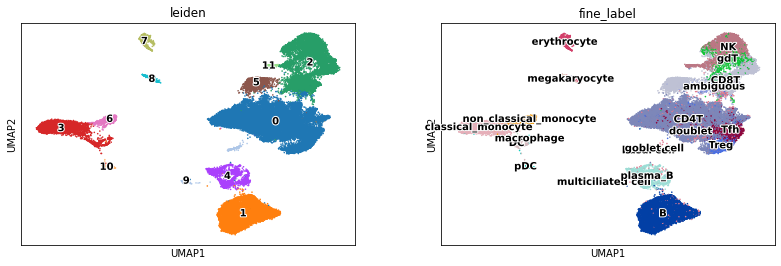

In [151]:
# update the original object
adata2.obs['fine_label'] = adata2.obs['fine_label'].astype('object')
adata2.obs['fine_label'].update(rna_x.obs['fine_label'].astype('object'))
sc.pl.umap(adata2, color = ['leiden', 'fine_label'], size = 10, legend_loc = 'on data', legend_fontoutline=2)

### Remove remnant doublets and recluster

In [152]:
adata.obs = adata2.obs.copy()
adata_raw.obs = adata2.obs.copy()
# make a copy just incase i wish to redo 
adata_copy = adata.copy()
adata_raw_copy = adata_raw.copy()
# remove doublets
adata = adata[~(adata.obs['fine_label'].isin(['doublet', 'ambiguous']))]
adata_raw = adata_raw[~(adata_raw.obs['fine_label'].isin(['doublet', 'ambiguous']))]
adata

View of AnnData object with n_obs × n_vars = 47625 × 746
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'sampleid_colors', 'patient_colors', 'sampletype_colors', 'leiden', 'group_colors', 'gender_colors', 'rank_genes_groups', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [153]:
# recluster
adata2 = sc.AnnData(X = adata.raw.X, var = adata.raw.var, obs = adata.obs, raw = adata.raw)
adata2

AnnData object with n_obs × n_vars = 47625 × 20764
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells'

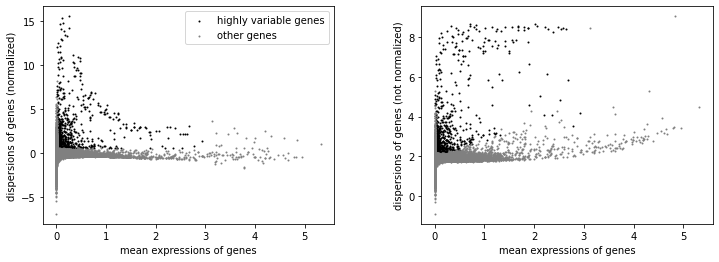

In [154]:
# Identify highly-variable genes
sc.pp.highly_variable_genes(adata2, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
# plot highly_variable_genes
sc.pl.highly_variable_genes(adata2)

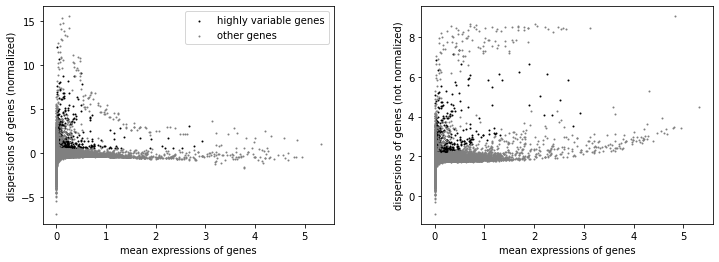

In [155]:
## remove TRBV/TRAV and IGHV/IGLV/IGKV from the highly variable genes
import re
for i in adata2.var.index:
    if re.search('^TR[ABGD]V|^IG[HKL]V', i):
        adata2.var.at[i, 'highly_variable'] = False
sc.pl.highly_variable_genes(adata2)

In [156]:
# filter to only highly variable
adata2 = adata2[:, adata2.var['highly_variable']]
adata2

View of AnnData object with n_obs × n_vars = 47625 × 785
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'

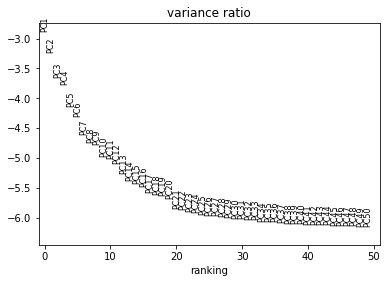

In [157]:
import multiprocessing
# regress and scale for PCA
sc.pp.regress_out(adata2, ['n_counts', 'percent_mito'], n_jobs = multiprocessing.cpu_count()-4)
sc.pp.scale(adata2, max_value = 10)
# Principal component analysis
sc.tl.pca(adata2, svd_solver = 'arpack')
sc.pl.pca_variance_ratio(adata2, log = True, n_pcs = 50)

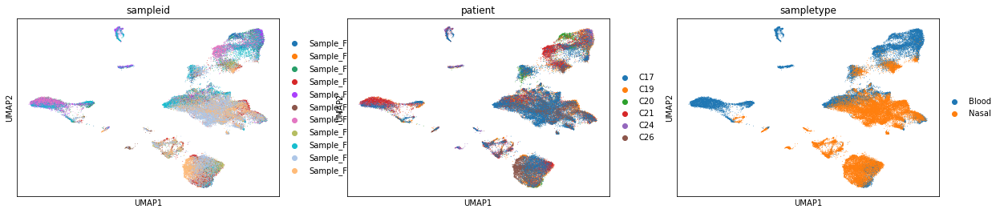

In [158]:
# run BBKNN
sc.external.pp.bbknn(adata2, batch_key = 'patient', neighbors_within_batch=10)
# UMAP
sc.tl.umap(adata2, n_components = 2, min_dist = 0.3)
sc.pl.umap(adata2, color=['sampleid', 'patient', 'sampletype'])

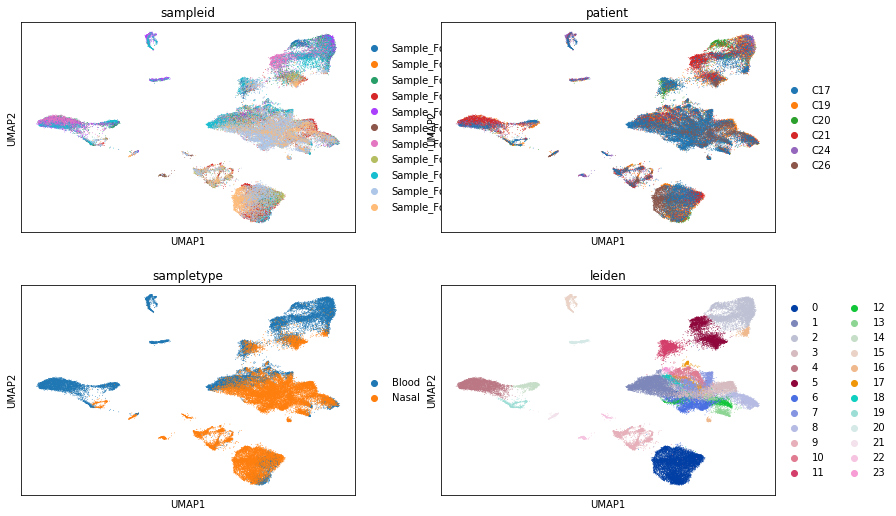

In [159]:
# find clusters
sc.tl.leiden(adata2)
sc.pl.umap(adata2, color=['sampleid', 'patient', 'sampletype', 'leiden'], ncols = 2)

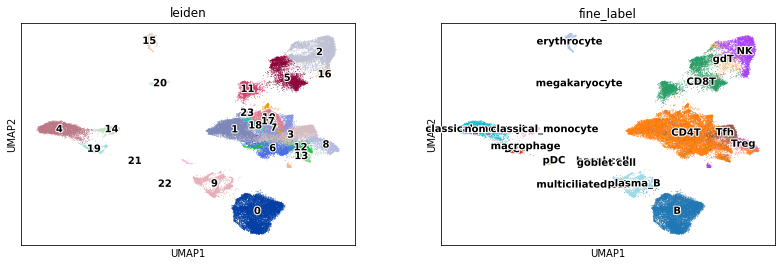

In [160]:

sc.pl.umap(adata2, color=['leiden', 'fine_label'], legend_loc = 'on data', legend_fontoutline=2)

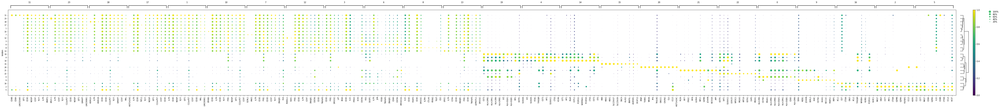

In [161]:
sc.tl.rank_genes_groups(adata2, groupby = 'leiden', method = 'wilcoxon')
sc.tl.filter_rank_genes_groups(adata2, min_fold_change=1)
sc.tl.dendrogram(adata2, groupby = 'leiden')
sc.pl.rank_genes_groups_dotplot(adata2, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered')

... storing 'broad_label' as categorical


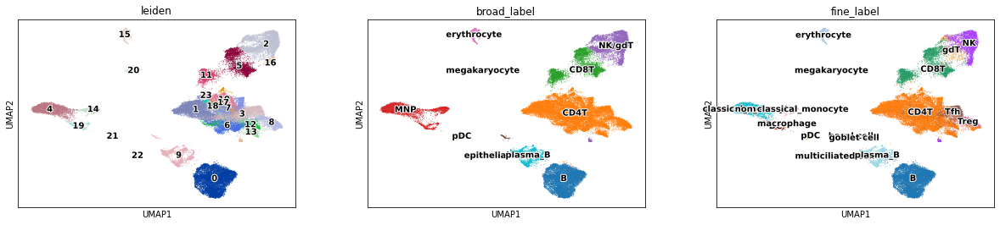

In [162]:
# give broad annoations
new_dict = {'0':'B',
'1':'CD4T',
'2':'NK/gdT',
'3':'CD4T',
'4':'MNP',
'5':'CD8T',
'6':'CD4T',
'7':'CD4T',
'8':'CD4T',
'9':'plasma_B',
'10':'CD4T',
'11':'CD8T',
'12':'CD4T',
'13':'CD4T',
'14':'MNP',
'15':'erythrocyte',
'16':'NK/gdT',
'17':'CD4T',
'18':'CD4T',
'19':'MNP',
'20':'megakaryocyte',
'21':'pDC',
'22':'epithelial',
'23':'CD4T'}
adata2.obs['broad_label'] = [new_dict[l] for l in adata2.obs['leiden']]
sc.pl.umap(adata2, color=['leiden', 'broad_label', 'fine_label'], legend_fontoutline=2, legend_loc = 'on data')

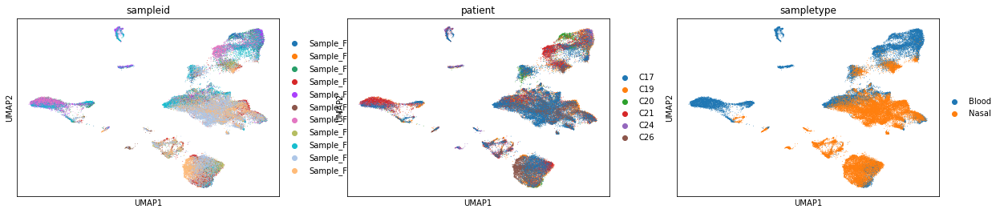

In [163]:
sc.pl.umap(adata2, color=['sampleid', 'patient', 'sampletype'])

In [164]:
# transfer and save!
adata.obs = adata2.obs.copy()
adata_raw.obs = adata2.obs.copy()
adata.obsm.update(adata2.obsm)
adata_raw.obsm.update(adata2.obsm)
adata.obsp = adata2.obsp.copy()
adata_raw.obsp = adata2.obsp.copy()
adata.write('out/adata_control.h5ad', compression = 'gzip')
adata_raw.write('out/adata_control_raw.h5ad', compression = 'gzip')

In [165]:
adata

AnnData object with n_obs × n_vars = 47625 × 746
    obs: 'sampleid', 'patient', 'sampletype', 'group', 'gender', 'scrublet_score', 'n_genes', 'percent_mito', 'n_counts', 'bh_pval', 'is_doublet', 'filter_rna', 'batch', 'leiden', 'fine_label', '__is_in_cluster__', 'broad_label'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'sampleid_colors', 'patient_colors', 'sampletype_colors', 'leiden', 'group_colors', 'gender_colors', 'rank_genes_groups', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [166]:
# check how many cells
pd.crosstab(adata.obs['sampletype'], adata.obs['patient'])

patient,C17,C19,C20,C21,C24,C26
sampletype,,,,,,
Blood,4155,4165,3946,4329,2912,0
Nasal,12077,6155,1391,3565,1470,3460
